# Lending Tree Loan Status: Upsampling
## Classification - Random Forest HPO GPU

## Set Up Environment, Read Data, Split Train/Validation Sets

In [ ]:
# Upgrade pip
!pip install --upgrade pip

In [ ]:
# Install/import dependencies
!pip install --upgrade -q wandb
!pip install optuna
!pip install dask_optuna
!pip install eli5
!pip install shap
!pip install plotly
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask.utils import parse_bytes
from dask_cuda import LocalCUDACluster
import dask_cudf
import dask_optuna
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import cudf
import cuml
from cuml.model_selection import train_test_split
from cuml.ensemble import RandomForestClassifier
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import joblib
from joblib import parallel_backend
import pickle
import pandas as pd
import sklearn
from sklearn.metrics import f1_score
from sklearn.metrics import fbeta_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score
from sklearn.inspection import permutation_importance
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
from eli5 import show_weights
import webbrowser
from eli5.sklearn import explain_weights_sklearn
from eli5.formatters import format_as_dataframe, format_as_dataframes
import shap
warnings.filterwarnings('ignore')
my_dpi=96

os.environ['CUDA_VISIBLE_DEVICES'] = '0'

print('\n')
!nvidia-smi



Mon Oct  3 23:32:17 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   41C    P8    15W / 140W |    157MiB / 16376MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----

In [ ]:
# Set up local CUDA cluster for Dask
cluster = LocalCUDACluster(
    CUDA_VISIBLE_DEVICES='0',
    rmm_pool_size=parse_bytes('9G'), # This GPU has 16GB of memory
    device_memory_limit=parse_bytes('7GB'),
    threads_per_worker=1, 
    ip='0.0.0.0',
)
c = Client(cluster)

# Query the client for all connected workers
workers = c.has_what().keys()
n_workers = len(workers)
c

# Shut down the cluster
#c.shutdown()
#cluster.close()
#c.close()

distributed.preloading - INFO - Import preload module: dask_cuda.initialize


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.92.202:8787/status,
Dashboard: http://10.42.92.202:8787/status,Workers: 1
Total threads: 1,Total memory: 39.94 GiB
Status: running,Using processes: True
Comm: tcp://10.42.92.202:39889,Workers: 1
Dashboard: http://10.42.92.202:8787/status,Total threads: 1
Started: Just now,Total memory: 39.94 GiB
Comm: tcp://10.42.92.202:43565,Total threads: 1
Dashboard: http://10.42.92.202:45031/status,Memory: 39.94 GiB
Nanny: tcp://10.42.92.202:35567,


In [ ]:
# Define function to time code blocks
@contextmanager
def timed(name):
    t0 = time.time()
    yield
    t1 = time.time()
    print('..%-24s:  %8.4f' % (name, t1 - t0))

In [ ]:
# Set seed 
seed_value = 42
os.environ['rfRAPIDS_GPU'] = str(seed_value)
random.seed(seed_value)
cupy.random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
%cd /notebooks/LoanStatus/Data/

/notebooks/LoanStatus/Data


In [ ]:
# Read data
trainDF = cudf.read_csv('trainDF_US.csv', low_memory=False)
print('Train set: Number of rows and columns:', trainDF.shape)

testDF = cudf.read_csv('testDF_US.csv', low_memory=False)
print('Test set: Number of rows and columns:', testDF.shape)

Train set: Number of rows and columns: (3022132, 51)
Test set: Number of rows and columns: (432473, 51)


In [ ]:
# Split train set into train and validation set
X_train, X_val, y_train, y_val = train_test_split(trainDF, 'loan_status', 
                                                  train_size=0.8)

# Convert data types for modeling
X_train = X_train.astype('float32')
X_val = X_val.astype('float32')
y_train = y_train.astype('int32')
y_val = y_val.astype('int32')

## Weighted F1

### 100 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_weightedF1_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf100gpu_trainvaltest', 
                'save_code': 'False', 'notes': 'us_rf100gpu_trainvaltest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_100_GPU_f1weighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')

    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_100_GPU_f1weighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 43.70615311595611
- Trial weighted F1: 0.9354544258819555
######################################################
- Trial time: 53.02057957998477
- Trial weighted F1: 0.9298510387708205
######################################################
- Trial time: 70.1661686799489
- Trial weighted F1: 0.9277740933927645
######################################################
- Trial time: 46.14979056897573
- Trial weighted F1: 0.9275803561480372
######################################################
- Trial time: 68.17144892504439
- Trial weighted F1: 0.9279373429191855
######################################################
- Trial time: 36.636580002028495
- Trial weighted F1: 0.9353930841848316
######################################################
- Trial time: 36.85740006505512
- Trial weighted F1: 0.9315334310994107
######################################################
- Trial time: 56.8568625159096
- Trial weighted F1: 0.9317307299957021
########################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'f1_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_100_GPU_f1weighted.csv', index=False)
print(trials_df) 

    iteration  f1_weighted             datetime_start  \
58         58     0.936747 2022-09-22 01:27:55.582705   
81         81     0.936165 2022-09-22 01:53:46.155556   
99         99     0.936126 2022-09-22 02:10:26.691580   
67         67     0.936121 2022-09-22 01:38:31.815687   
91         91     0.935989 2022-09-22 02:03:29.206094   
..        ...          ...                        ...   
3           3     0.927580 2022-09-22 00:48:24.802988   
76         76     0.926237 2022-09-22 01:48:40.270886   
38         38     0.925627 2022-09-22 01:12:52.277516   
37         37     0.922904 2022-09-22 01:12:12.053225   
14         14     0.922842 2022-09-22 00:56:16.726307   

            datetime_complete               duration  max_depth  max_leaves  \
58 2022-09-22 01:29:00.153703 0 days 00:01:04.570998         29         300   
81 2022-09-22 01:54:40.503084 0 days 00:00:54.347528         29         300   
99 2022-09-22 02:11:28.620883 0 days 00:01:01.929303         17         300   

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

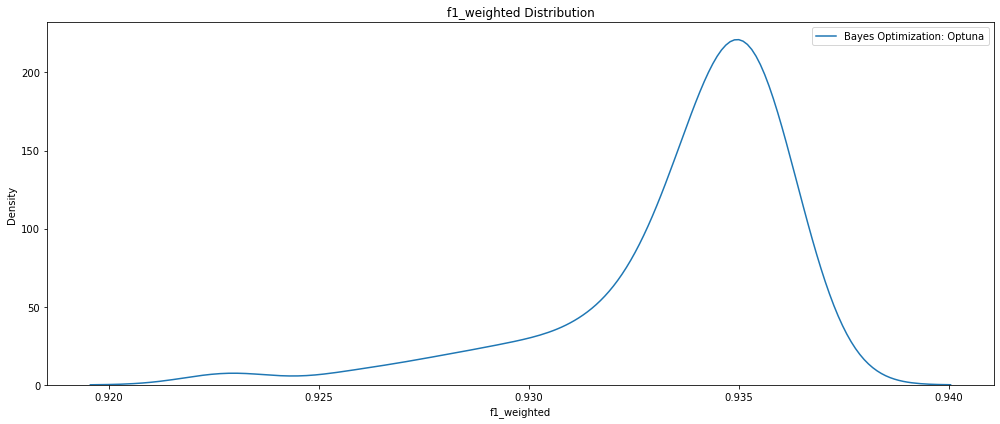

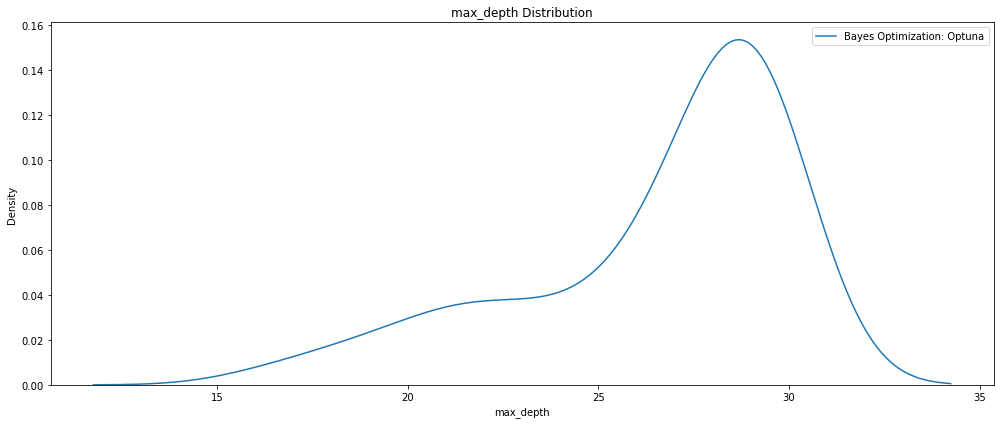

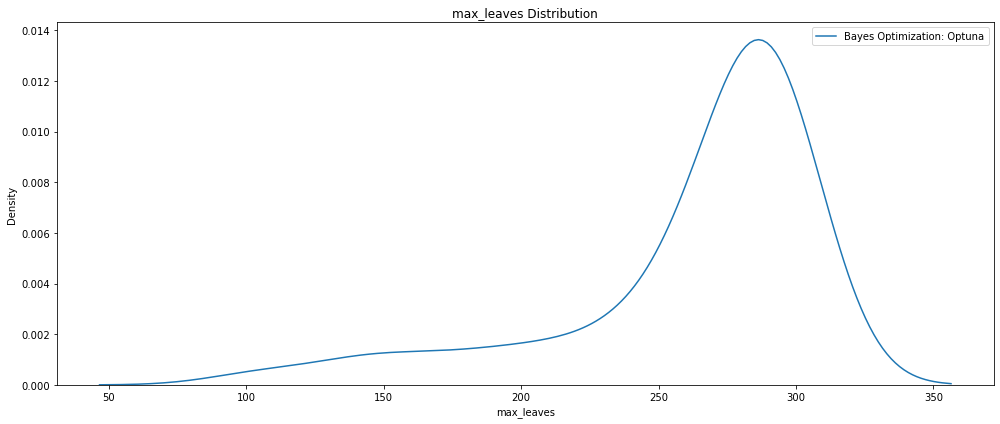

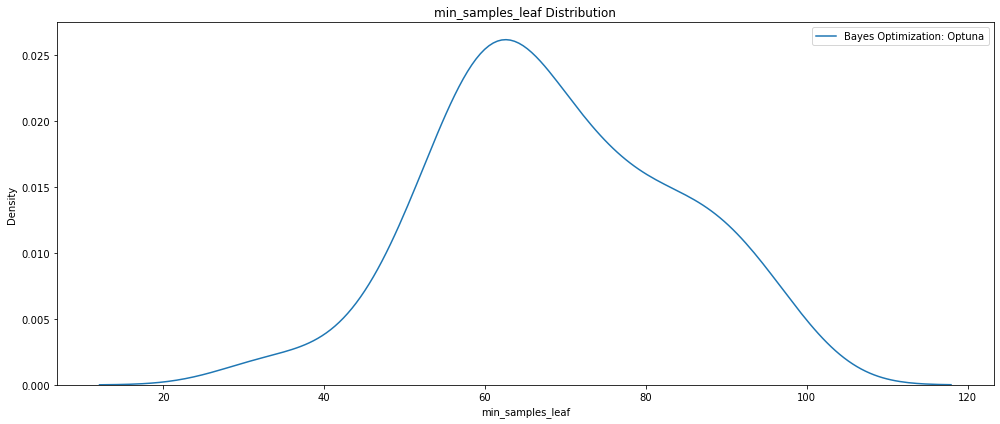

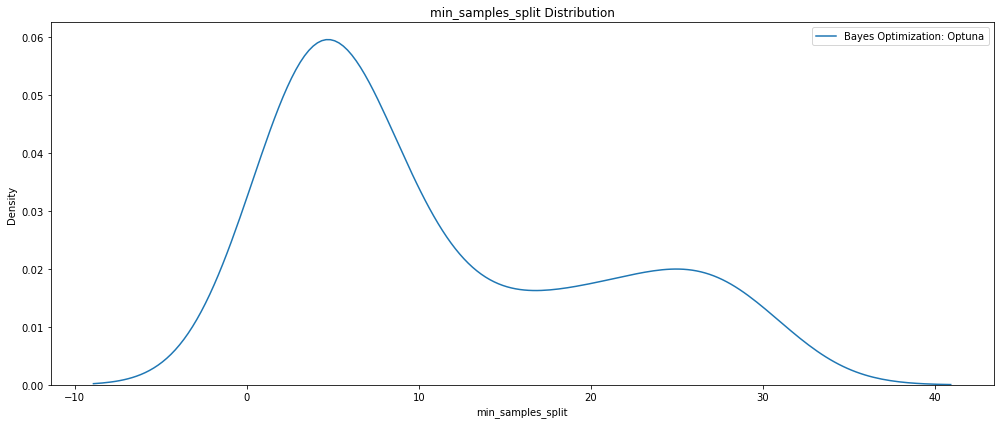

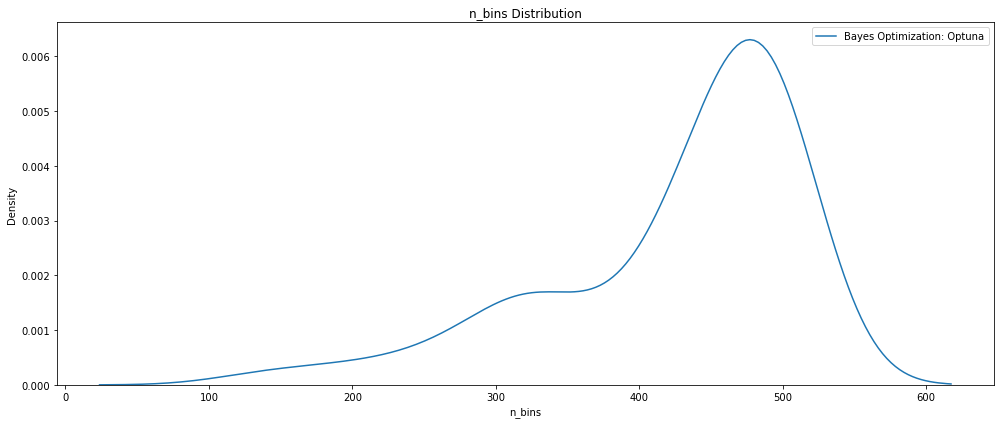

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

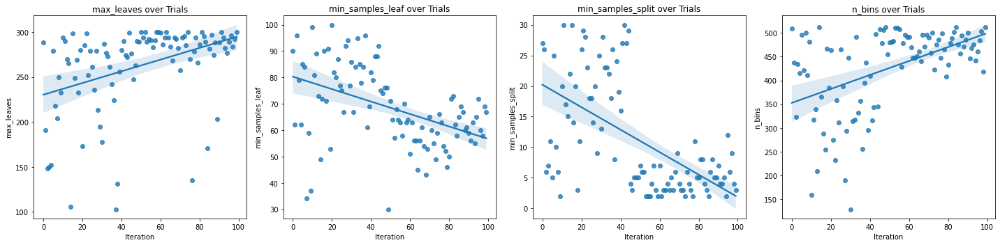

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_f1weighted.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_US_100_GPU_f1weighted.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 100
Best trial: {'n_estimators': 418, 'max_depth': 29, 'max_leaves': 300, 'min_samples_leaf': 63, 'min_samples_split': 3, 'n_bins': 496}
Highest F1 Score 0.9367468778438117
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params  
params['random_state'] = seed_value
params

{'n_estimators': 418,
 'max_depth': 29,
 'max_leaves': 300,
 'min_samples_leaf': 63,
 'min_samples_split': 3,
 'n_bins': 496,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_100trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_US_100trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for RF RAPIDS HPO US 100 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for RF RAPIDS HPO US 100 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97    377848
           1       0.78      0.91      0.84     54625

    accuracy                           0.96    432473
   macro avg       0.88      0.94      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[364114  13734]
 [  5095  49530]]


Accuracy score : 0.956
Precision score : 0.783
Recall score : 0.907
F1 score : 0.840


In [ ]:
# Evaluate on the testing data 
print('The best model from US 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 100 GPU trials optimization scores 0.93519 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    58
f1_weighted                            0.936747
datetime_start       2022-09-22 01:27:55.582705
datetime_complete    2022-09-22 01:29:00.153703
duration                 0 days 00:01:04.570998
max_depth                                    29
max_leaves                                  300
min_samples_leaf                             63
min_samples_split                             3
n_bins                                      496
n_estimators                                418
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with ELI5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1845 ± 0.0009,out_prncp
0.0676 ± 0.0002,recoveries
0.0491 ± 0.0002,total_pymnt
0.0481 ± 0.0002,last_pymnt_amnt
0.0185 ± 0.0002,loan_amnt
0.0141 ± 0.0002,installment
0.0103 ± 0.0003,term_ 60 months
0.0069 ± 0.0004,total_rec_late_fee
0.0004 ± 0.0001,initial_list_status_w
0.0004 ± 0.0001,total_bc_limit


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_100_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.184461,0.000472
1,recoveries,0.067587,0.000109
2,total_pymnt,0.049064,0.000094
3,last_pymnt_amnt,0.048089,0.000113
4,loan_amnt,0.018512,0.000118
5,installment,0.014097,0.000098
6,term_ 60 months,0.010280,0.000165
7,total_rec_late_fee,0.006918,0.000177
8,initial_list_status_w,0.000442,0.000025
9,total_bc_limit,0.000419,0.000026


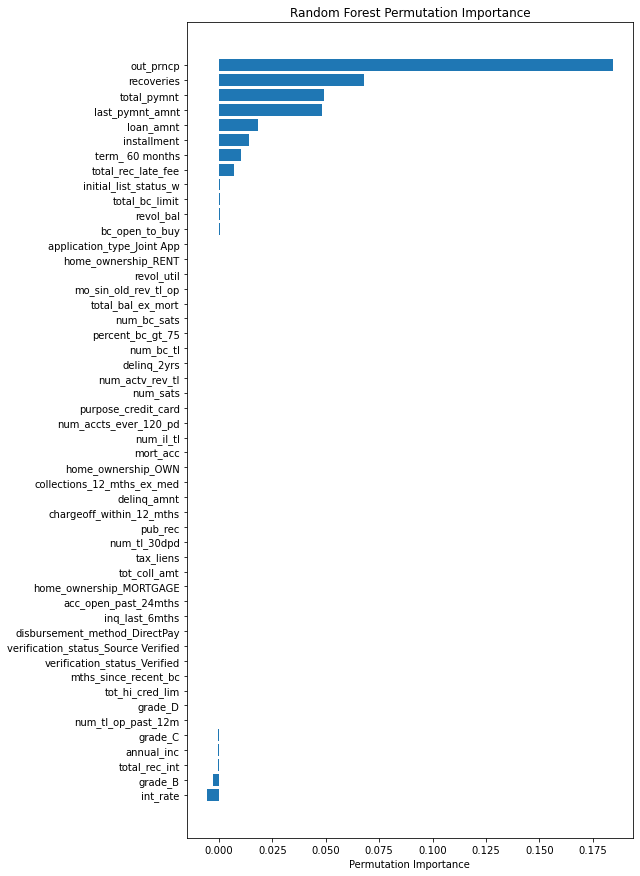

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_100_GPU_f1weighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_weightedF1_300_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf300gpu_trainvaltest', 
                'save_code': 'False', 'notes': 'us_rf300gpu_trainvaltest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_300_GPU_f1weighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 270, 700),
        'max_depth': trial.suggest_int('max_depth', 15, 40), 
        'max_leaves': trial.suggest_int('max_leaves', 270, 400), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 50, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 15),
        'n_bins': trial.suggest_int('n_bins', 445, 600),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')

    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_f1weighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 78.47936849389225
- Trial weighted F1: 0.9359381072838707
######################################################
- Trial time: 72.16274237213656
- Trial weighted F1: 0.9365903342528817
######################################################
- Trial time: 44.37801014864817
- Trial weighted F1: 0.9347904507504676
######################################################
- Trial time: 48.046305157244205
- Trial weighted F1: 0.9361085077662551
######################################################
- Trial time: 69.10447692591697
- Trial weighted F1: 0.9358468841753596
######################################################
- Trial time: 56.990876151714474
- Trial weighted F1: 0.936341488958966
######################################################
- Trial time: 52.80296091083437
- Trial weighted F1: 0.936870341602826
######################################################
- Trial time: 81.86673834873363
- Trial weighted F1: 0.9372393987039561
#######################################

In [ ]:
study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_f1weighted.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)

Number of finished trials: 279
Best trial: {'n_estimators': 391, 'max_depth': 24, 'max_leaves': 398, 'min_samples_leaf': 81, 'min_samples_split': 2, 'n_bins': 575}
Highest F1 Score 0.9393092287581267


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_f1weighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=21)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 68.06663914304227
- Trial weighted F1: 0.9382176982209097
######################################################
- Trial time: 64.45354749681428
- Trial weighted F1: 0.9386122585956322
######################################################
- Trial time: 59.93158024782315
- Trial weighted F1: 0.9384438472548514
######################################################
- Trial time: 44.09009192418307
- Trial weighted F1: 0.9378518162941871
######################################################
- Trial time: 107.33597528608516
- Trial weighted F1: 0.9377926687202501
######################################################
- Trial time: 66.04380498593673
- Trial weighted F1: 0.938599371612607
######################################################
- Trial time: 62.234471757896245
- Trial weighted F1: 0.9376841564900238
######################################################
- Trial time: 69.7631080658175
- Trial weighted F1: 0.939024664120192
########################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'f1_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_300_GPU_f1weighted.csv', index=False)
print(trials_df) 

     iteration  f1_weighted             datetime_start  \
251        251     0.939309 2022-09-28 11:12:56.873253   
237        237     0.939210 2022-09-28 10:57:36.612224   
257        257     0.939208 2022-09-28 11:19:01.872592   
102        102     0.939163 2022-09-28 08:30:45.318412   
207        207     0.939111 2022-09-28 10:24:40.543049   
..         ...          ...                        ...   
2            2     0.934790 2022-09-28 06:32:35.860391   
35          35     0.934501 2022-09-28 07:17:05.129131   
49          49     0.934278 2022-09-28 07:32:42.448835   
8            8     0.933720 2022-09-28 06:38:31.103278   
278        278          NaN 2022-09-28 11:41:22.199963   

             datetime_complete               duration  max_depth  max_leaves  \
251 2022-09-28 11:13:58.284501 0 days 00:01:01.411248       24.0       398.0   
237 2022-09-28 10:58:43.133045 0 days 00:01:06.520821       27.0       400.0   
257 2022-09-28 11:20:01.484713 0 days 00:00:59.612121       28.

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

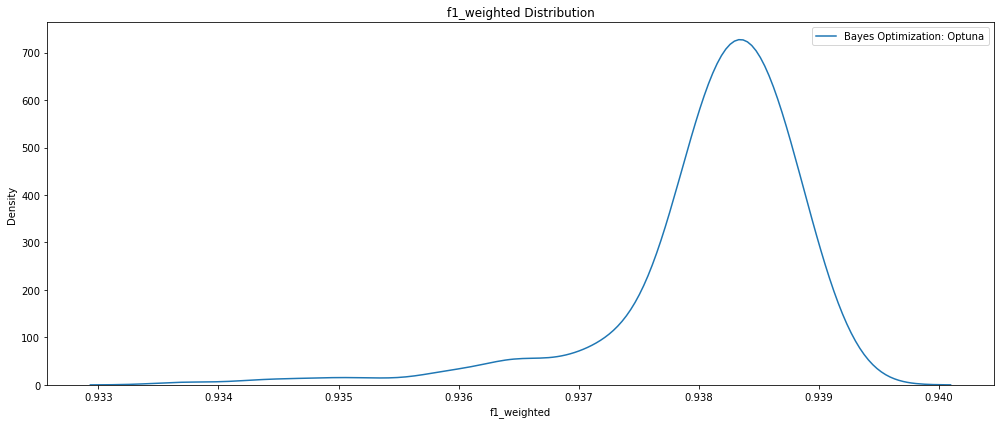

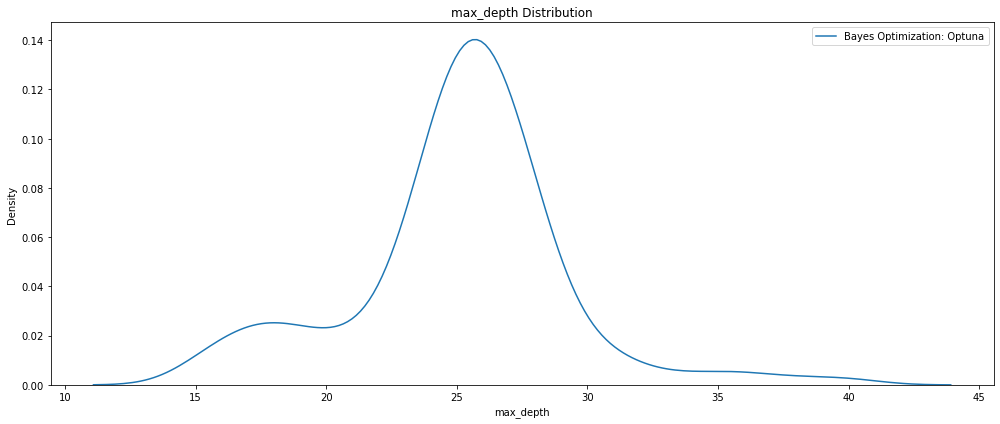

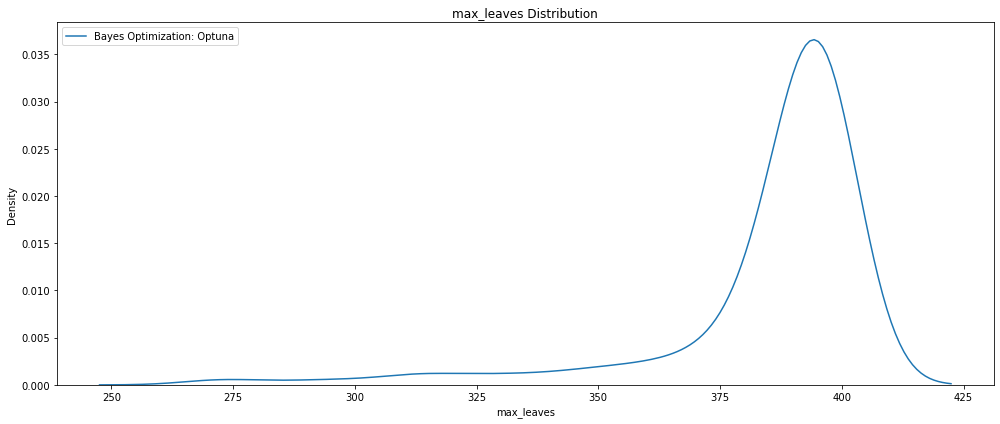

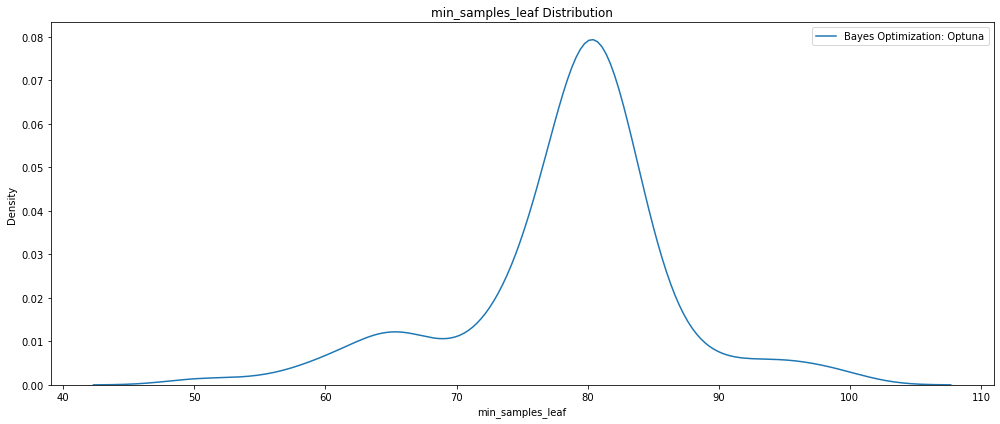

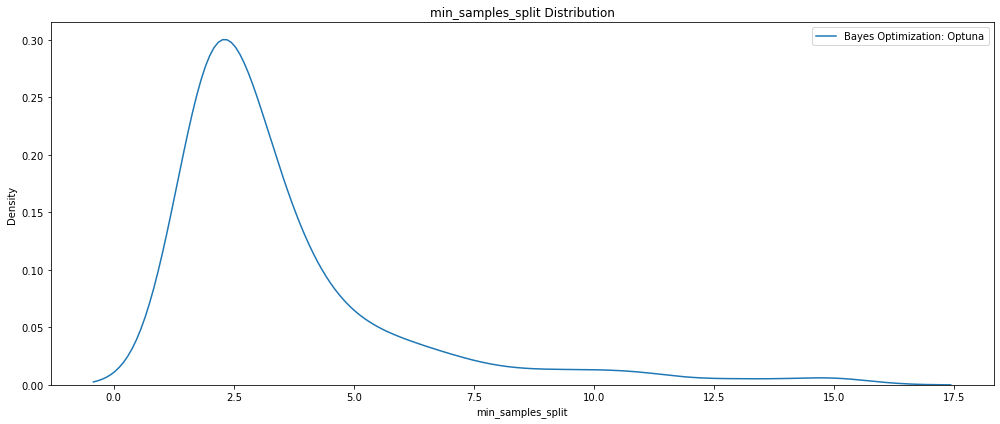

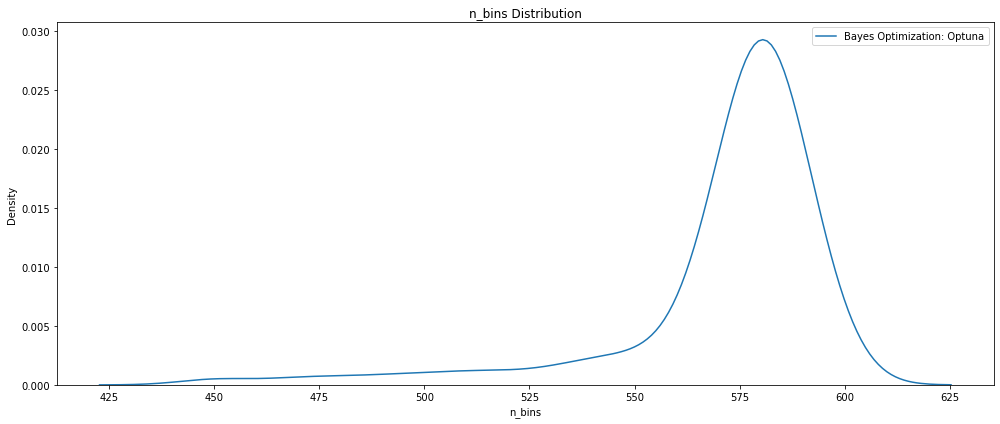

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

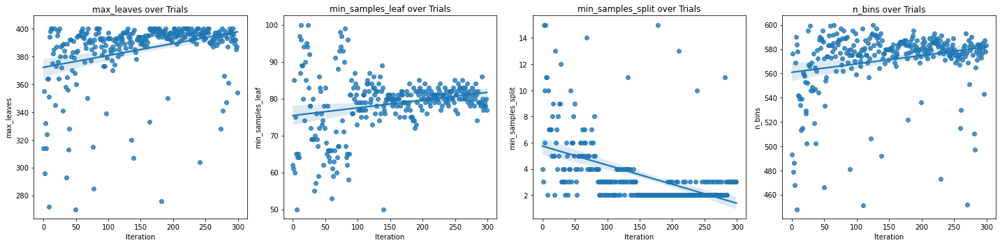

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_f1weighted.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_US_300_GPU_f1weighted.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 100
Best trial: {'n_estimators': 418, 'max_depth': 29, 'max_leaves': 300, 'min_samples_leaf': 63, 'min_samples_split': 3, 'n_bins': 496}
Highest F1 Score 0.9367468778438117
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params  
params['random_state'] = seed_value
params

{'n_estimators': 391,
 'max_depth': 24,
 'max_leaves': 398,
 'min_samples_leaf': 81,
 'min_samples_split': 2,
 'n_bins': 575,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1,
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_300trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_US_300trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for RF RAPIDS HPO US 300 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for RF RAPIDS HPO US 300 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.97      0.98    377848
           1       0.80      0.91      0.85     54625

    accuracy                           0.96    432473
   macro avg       0.89      0.94      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[365392  12456]
 [  4947  49678]]


Accuracy score : 0.960
Precision score : 0.800
Recall score : 0.909
F1 score : 0.851


In [ ]:
# Evaluate on the testing data 
print('The best model from US 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 300 GPU trials optimization scores 0.93824 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   251
f1_weighted                            0.939309
datetime_start       2022-09-28 11:12:56.873253
datetime_complete    2022-09-28 11:13:58.284501
duration                 0 days 00:01:01.411248
max_depth                                  24.0
max_leaves                                398.0
min_samples_leaf                           81.0
min_samples_split                           2.0
n_bins                                    575.0
n_estimators                              391.0
state                                  COMPLETE
Name: 251, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

In [ ]:
# Model metrics with ELI5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1928 ± 0.0011,out_prncp
0.0662 ± 0.0001,recoveries
0.0534 ± 0.0002,total_pymnt
0.0431 ± 0.0002,last_pymnt_amnt
0.0208 ± 0.0003,loan_amnt
0.0156 ± 0.0003,installment
0.0111 ± 0.0002,term_ 60 months
0.0066 ± 0.0003,total_rec_late_fee
0.0005 ± 0.0001,total_bc_limit
0.0004 ± 0.0000,initial_list_status_w


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_300_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.192754,0.000527
1,recoveries,0.066196,0.000050
2,total_pymnt,0.053393,0.000093
3,last_pymnt_amnt,0.043096,0.000103
4,loan_amnt,0.020798,0.000129
5,installment,0.015564,0.000142
6,term_ 60 months,0.011112,0.000106
7,total_rec_late_fee,0.006629,0.000166
8,total_bc_limit,0.000495,0.000036
9,initial_list_status_w,0.000381,0.000012


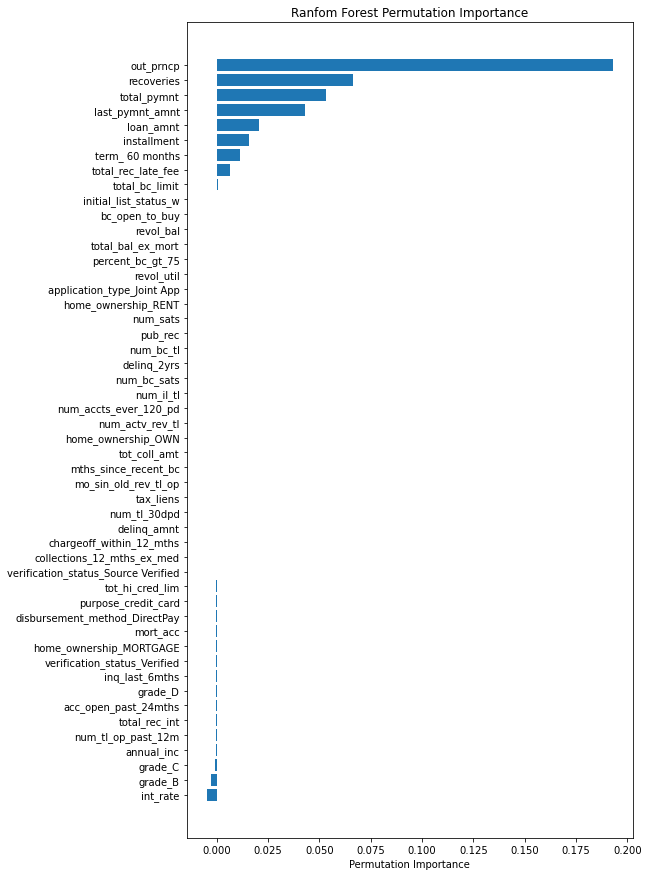

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Ranfom Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_300_GPU_f1weighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Precision

### 100 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_precision_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

# called us but it's US
wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf100gpu_trainvaltest_precision', 
                'save_code': 'False', 'notes': 'us_rf100gpu_trainvaltest_precision'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_100_GPU_precision.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = precision_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial precision:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_100_GPU_precision.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_precision.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)
wandb.finish()

- Trial time: 51.001211900031194
- Trial precision: 0.9560620383012989
######################################################
- Trial time: 21.788712916895747
- Trial precision: 0.9482108996849052
######################################################
- Trial time: 59.193580514984205
- Trial precision: 0.9528388102032599
######################################################
- Trial time: 24.79978961404413
- Trial precision: 0.9615978890480256
######################################################
- Trial time: 25.17721321899444
- Trial precision: 0.9549776149205838
######################################################
- Trial time: 55.984833121998236
- Trial precision: 0.961437726973904
######################################################
- Trial time: 56.36331613920629
- Trial precision: 0.9554557902219857
######################################################
- Trial time: 53.31002145214006
- Trial precision: 0.9590906695244286
####################################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'precision'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)
# Write processed data to csv
trials_df = trials_df.sort_values('precision', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_100_GPU_precision.csv', index=False)
print(trials_df) 

    iteration  precision             datetime_start  \
83         83   0.963007 2022-09-22 03:28:52.620478   
77         77   0.962970 2022-09-22 03:21:39.665849   
81         81   0.962733 2022-09-22 03:26:27.043172   
43         43   0.962567 2022-09-22 02:52:40.486119   
49         49   0.962403 2022-09-22 02:57:26.038824   
..        ...        ...                        ...   
20         20   0.952651 2022-09-22 02:31:06.762710   
37         37   0.951620 2022-09-22 02:46:35.684779   
1           1   0.948211 2022-09-22 02:17:09.866365   
68         68   0.946758 2022-09-22 03:11:58.385652   
16         16   0.946698 2022-09-22 02:28:30.262558   

            datetime_complete               duration  max_depth  max_leaves  \
83 2022-09-22 03:30:04.314310 0 days 00:01:11.693832         26         297   
77 2022-09-22 03:22:53.372841 0 days 00:01:13.706992         24         295   
81 2022-09-22 03:27:37.964754 0 days 00:01:10.921582         25         295   
43 2022-09-22 02:53:24.

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_100_GPU_precision.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_100_GPU_precision.html')
fig.show()

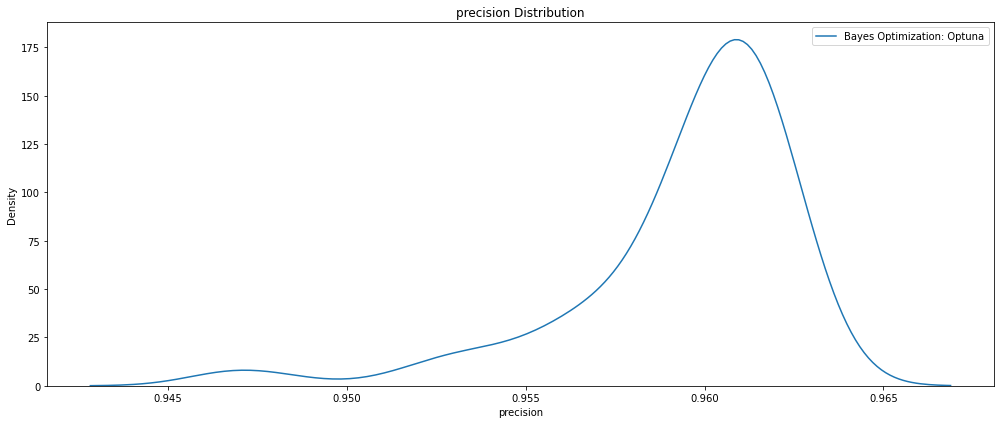

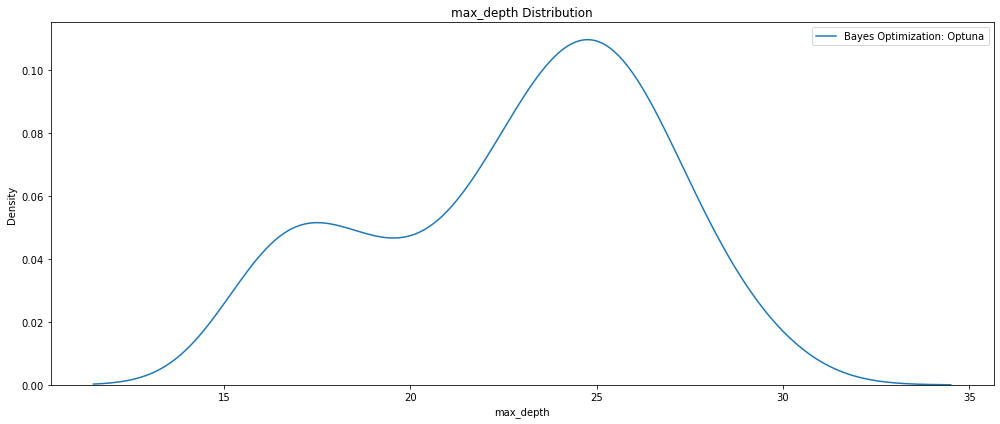

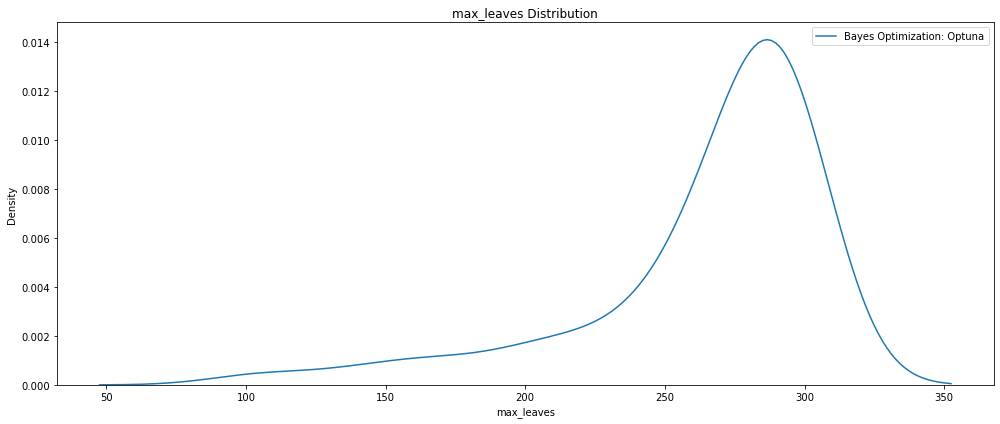

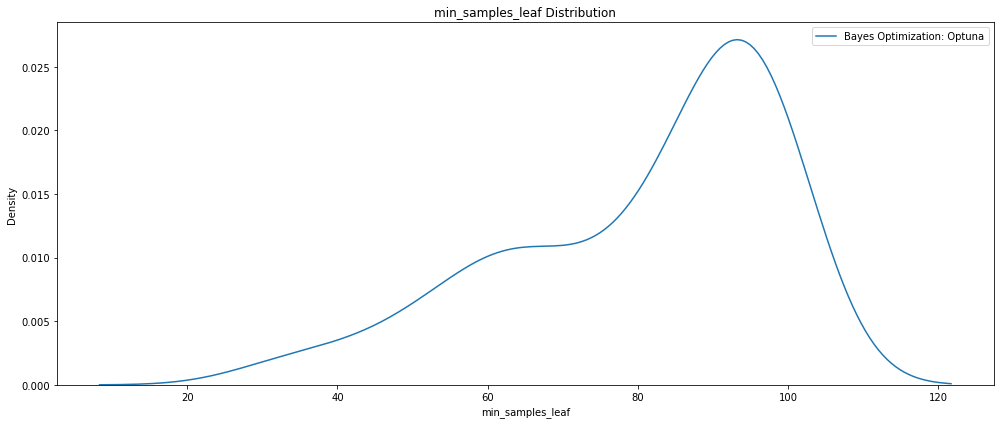

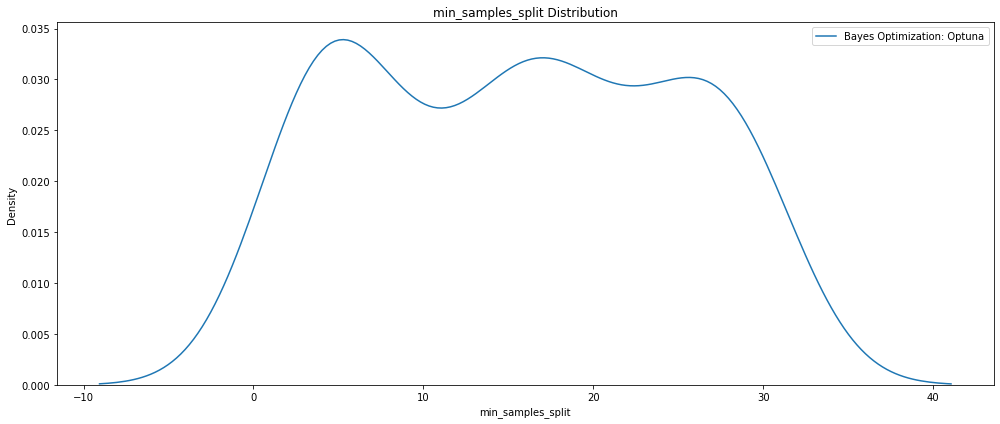

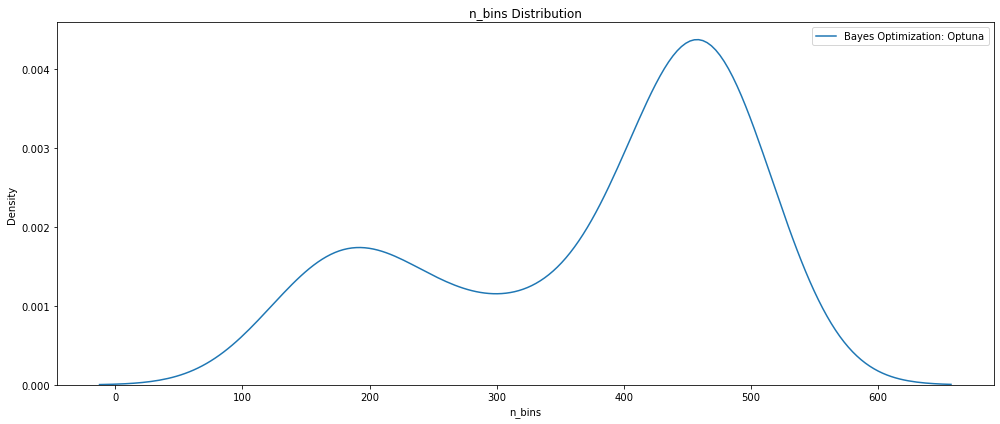

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

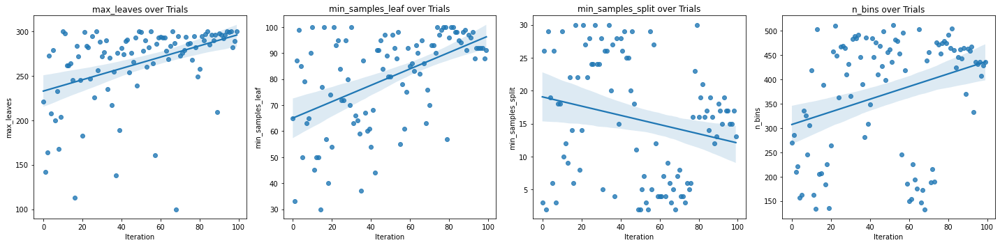

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_100_GPU_precision.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_100_GPU_precision.html')
fig.show()

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_precision.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_US_100_GPU_precision.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 100
Best trial: {'n_estimators': 467, 'max_depth': 26, 'max_leaves': 297, 'min_samples_leaf': 98, 'min_samples_split': 16, 'n_bins': 460}
Highest Precision Score 0.9630069920231848
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params  
params['random_state'] = seed_value
params

{'n_estimators': 467,
 'max_depth': 26,
 'max_leaves': 297,
 'min_samples_leaf': 98,
 'min_samples_split': 16,
 'n_bins': 460,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_100trials_GPU_precision.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_US_100trials_GPU_precision.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO US 100 trials GPU Precision')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO US 100 trials GPU Precision


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97    377848
           1       0.78      0.91      0.84     54625

    accuracy                           0.96    432473
   macro avg       0.88      0.94      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[363777  14071]
 [  5056  49569]]


Accuracy score : 0.956
Precision score : 0.779
Recall score : 0.907
F1 score : 0.838


In [ ]:
# Evaluate on the testing data 
print('The best model from US 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 100 GPU trials optimization scores 0.93510 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    83
precision                              0.963007
datetime_start       2022-09-22 03:28:52.620478
datetime_complete    2022-09-22 03:30:04.314310
duration                 0 days 00:01:11.693832
max_depth                                    26
max_leaves                                  297
min_samples_leaf                             98
min_samples_split                            16
n_bins                                      460
n_estimators                                467
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_precision_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_precision_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1868 ± 0.0009,out_prncp
0.0665 ± 0.0001,recoveries
0.0490 ± 0.0002,total_pymnt
0.0471 ± 0.0002,last_pymnt_amnt
0.0182 ± 0.0002,loan_amnt
0.0143 ± 0.0002,installment
0.0105 ± 0.0003,term_ 60 months
0.0065 ± 0.0003,total_rec_late_fee
0.0007 ± 0.0000,initial_list_status_w
0.0005 ± 0.0001,total_bc_limit


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_100_GPU_precision_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.186809,0.000446
1,recoveries,0.066531,0.000072
2,total_pymnt,0.048982,0.000093
3,last_pymnt_amnt,0.047100,0.000076
4,loan_amnt,0.018235,0.000096
5,installment,0.014294,0.000101
6,term_ 60 months,0.010499,0.000128
7,total_rec_late_fee,0.006467,0.000149
8,initial_list_status_w,0.000676,0.000024
9,total_bc_limit,0.000461,0.000041


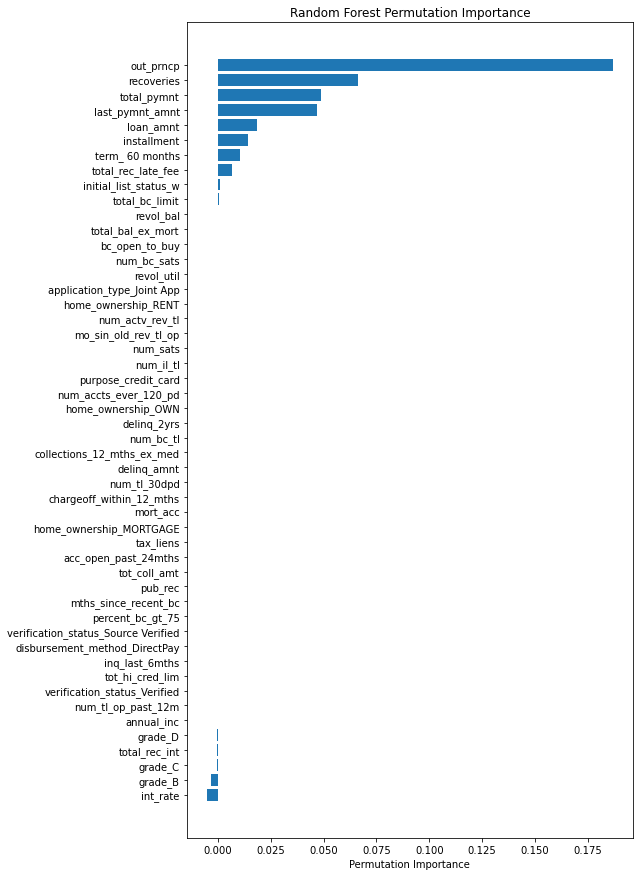

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_100_GPU_precision_permImportance.png', 
          dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_precision_300_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

# called us but it's US
wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf300gpu_trainvaltest_precision', 
                'save_code': 'False', 'notes': 'us_rf300gpu_trainvaltest_precision'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_300_GPU_precision.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 160, 600),
        'max_depth': trial.suggest_int('max_depth', 16, 50), 
        'max_leaves': trial.suggest_int('max_leaves', 270, 400), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 50, 150),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 50),
        'n_bins': trial.suggest_int('n_bins', 140, 600),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = precision_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial precision:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_precision.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_precision.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)
wandb.finish()

- Trial time: 68.5228534238413
- Trial precision: 0.9641078838174274
######################################################
- Trial time: 63.63141858018935
- Trial precision: 0.966118800461361
######################################################
- Trial time: 77.07776979869232
- Trial precision: 0.9641748922368403
######################################################
- Trial time: 105.65253954008222
- Trial precision: 0.9620796498905908
######################################################
- Trial time: 38.82752640824765
- Trial precision: 0.9570752441607651
######################################################
- Trial time: 114.28241985058412
- Trial precision: 0.965732492131295
######################################################
- Trial time: 76.8802104271017
- Trial precision: 0.9643271196801596
######################################################
- Trial time: 76.25995810702443
- Trial precision: 0.963444282833393
######################################################
- T

In [ ]:
study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_precision.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)

Number of finished trials: 223
Best trial: {'n_estimators': 457, 'max_depth': 32, 'max_leaves': 400, 'min_samples_leaf': 150, 'min_samples_split': 28, 'n_bins': 501}
Highest Precision Score 0.9686471377223586


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_precision.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_precision.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=77)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 69.86309675080702
- Trial precision: 0.9672576231982173
######################################################
- Trial time: 70.21272944426164
- Trial precision: 0.9668970765425835
######################################################
- Trial time: 71.49082682002336
- Trial precision: 0.9665958788083692
######################################################
- Trial time: 73.0078556779772
- Trial precision: 0.9671497856981728
######################################################
- Trial time: 66.90421093488112
- Trial precision: 0.9643783022190913
######################################################
- Trial time: 69.6360865579918
- Trial precision: 0.9670739101009531
######################################################
- Trial time: 74.80311522306874
- Trial precision: 0.966277611856193
######################################################
- Trial time: 71.10045472672209
- Trial precision: 0.9657007687758723
######################################################
- T

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'precision'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('precision', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_300_GPU_precision.csv', index=False)
print(trials_df) 

     iteration  precision             datetime_start  \
189        189   0.968647 2022-09-28 17:01:25.750438   
197        197   0.968549 2022-09-28 17:13:22.758232   
193        193   0.968292 2022-09-28 17:07:20.784866   
195        195   0.968282 2022-09-28 17:10:23.598351   
188        188   0.968228 2022-09-28 16:59:57.007836   
..         ...        ...                        ...   
3            3   0.962080 2022-09-28 12:42:55.746040   
37          37   0.961286 2022-09-28 13:29:27.729784   
9            9   0.960877 2022-09-28 12:51:01.473245   
4            4   0.957075 2022-09-28 12:44:41.799973   
222        222        NaN 2022-09-28 17:50:59.708999   

             datetime_complete               duration  max_depth  max_leaves  \
189 2022-09-28 17:02:54.677268 0 days 00:01:28.926830       32.0       400.0   
197 2022-09-28 17:14:50.770570 0 days 00:01:28.012338       33.0       400.0   
193 2022-09-28 17:08:50.239316 0 days 00:01:29.454450       31.0       400.0   
195 202

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_300_GPU_precision.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_300_GPU_precision.html')
fig.show()

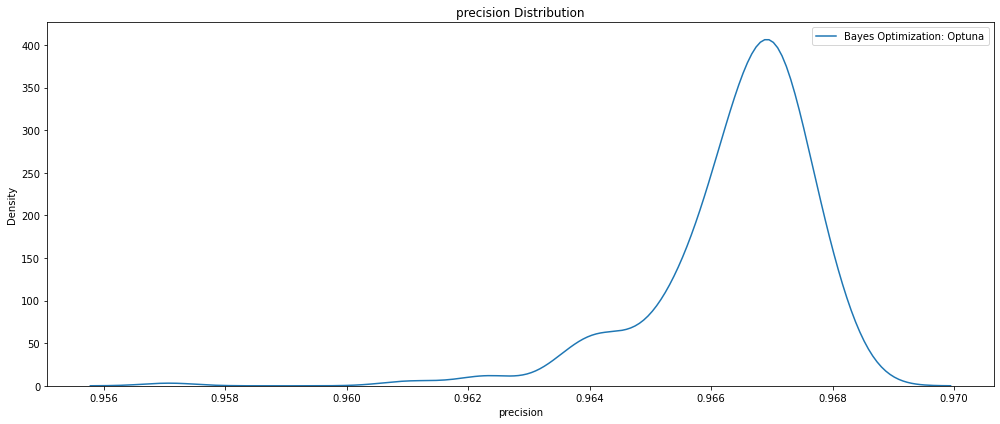

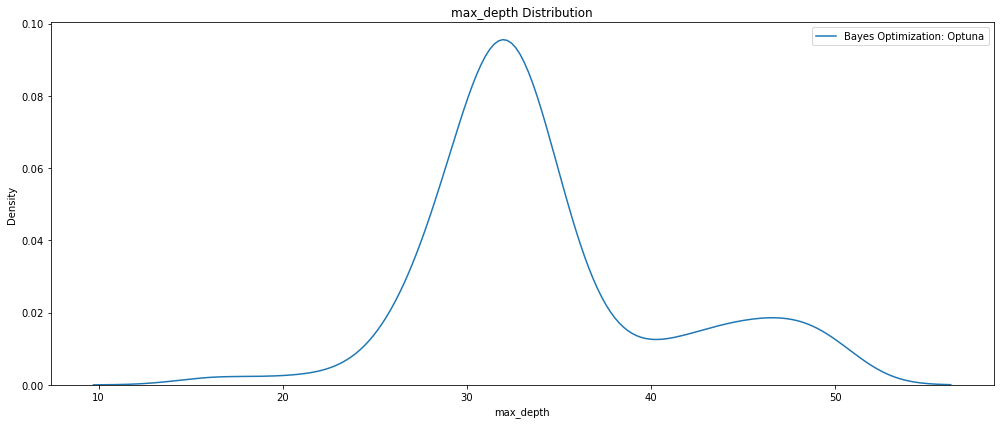

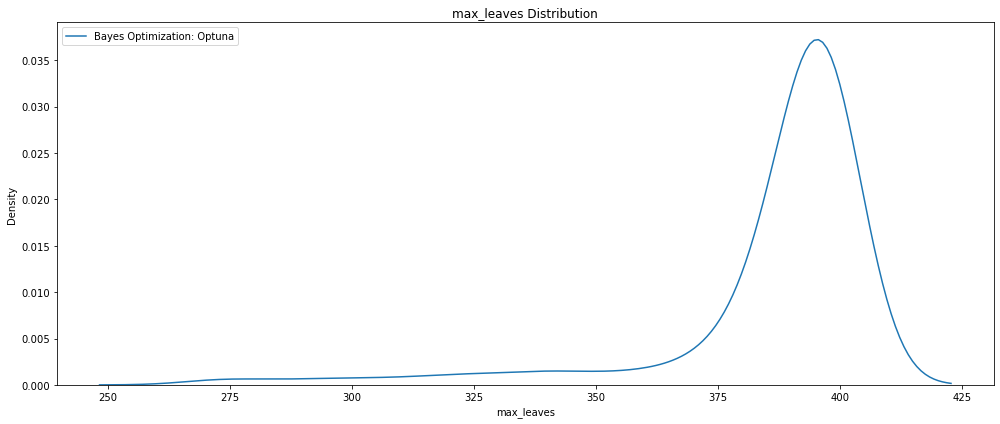

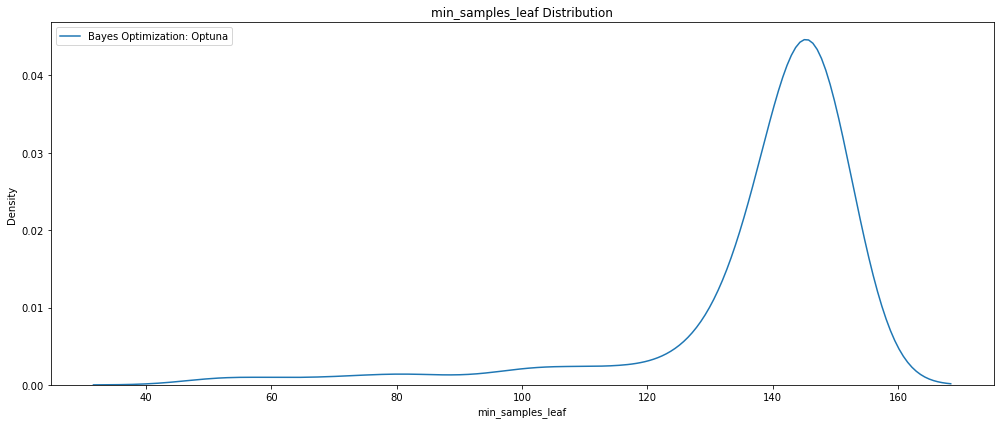

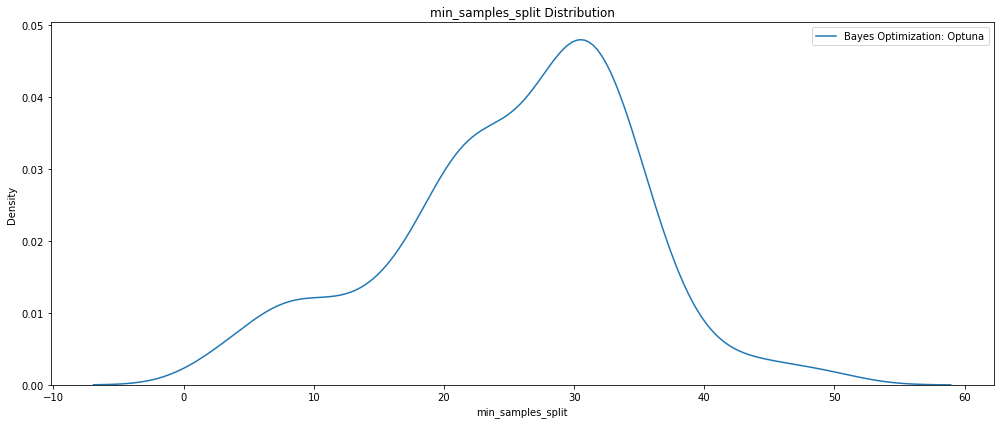

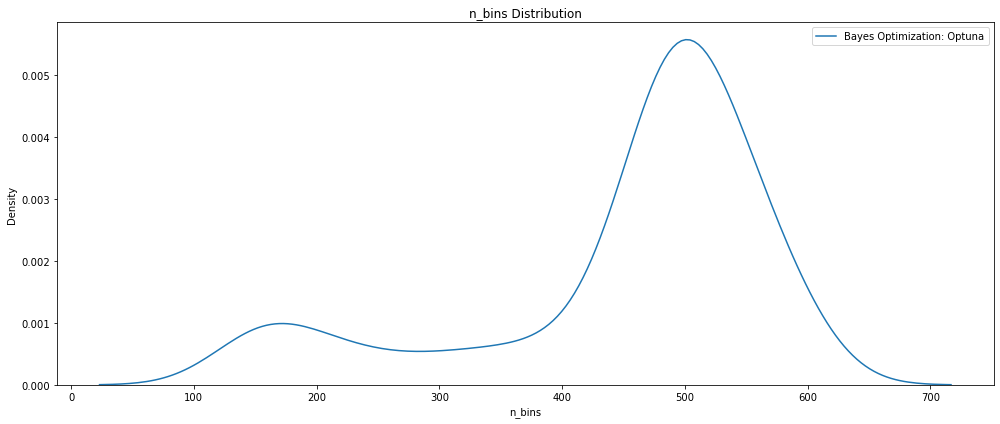

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

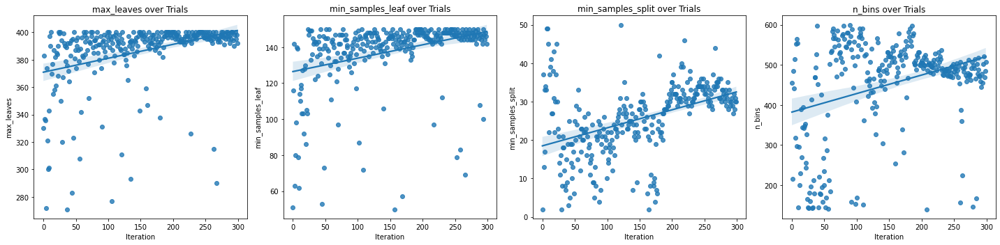

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_300_GPU_precision.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_300_GPU_precision.html')
fig.show()

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_precision.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Precision Score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_US_300_GPU_precision.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 100
Best trial: {'n_estimators': 467, 'max_depth': 26, 'max_leaves': 297, 'min_samples_leaf': 98, 'min_samples_split': 16, 'n_bins': 460}
Highest Precision Score 0.9630069920231848
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params  
params['random_state'] = seed_value
params

{'n_estimators': 457,
 'max_depth': 32,
 'max_leaves': 400,
 'min_samples_leaf': 150,
 'min_samples_split': 28,
 'n_bins': 501,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_300trials_GPU_precision.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_US_300trials_GPU_precision.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO US 300 trials GPU Precision')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO US 300 trials GPU Precision


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.97      0.98    377848
           1       0.81      0.91      0.86     54625

    accuracy                           0.96    432473
   macro avg       0.90      0.94      0.92    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[366197  11651]
 [  4932  49693]]


Accuracy score : 0.962
Precision score : 0.810
Recall score : 0.910
F1 score : 0.857


In [ ]:
# Evaluate on the testing data 
print('The best model from US 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 300 GPU trials optimization scores 0.93944 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   189
precision                              0.968647
datetime_start       2022-09-28 17:01:25.750438
datetime_complete    2022-09-28 17:02:54.677268
duration                 0 days 00:01:28.926830
max_depth                                  32.0
max_leaves                                400.0
min_samples_leaf                          150.0
min_samples_split                          28.0
n_bins                                    501.0
n_estimators                              457.0
state                                  COMPLETE
Name: 189, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_precision_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_precision_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1944 ± 0.0010,out_prncp
0.0662 ± 0.0002,recoveries
0.0545 ± 0.0001,total_pymnt
0.0444 ± 0.0003,last_pymnt_amnt
0.0222 ± 0.0002,loan_amnt
0.0170 ± 0.0002,installment
0.0115 ± 0.0003,term_ 60 months
0.0067 ± 0.0004,total_rec_late_fee
0.0005 ± 0.0001,initial_list_status_w
0.0004 ± 0.0000,bc_open_to_buy


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_300_GPU_precision_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.194359,0.000486
1,recoveries,0.066166,0.000078
2,total_pymnt,0.054478,0.000069
3,last_pymnt_amnt,0.044400,0.000153
4,loan_amnt,0.022222,0.000096
5,installment,0.016997,0.000090
6,term_ 60 months,0.011513,0.000157
7,total_rec_late_fee,0.006702,0.000179
8,initial_list_status_w,0.000549,0.000039
9,bc_open_to_buy,0.000437,0.000012


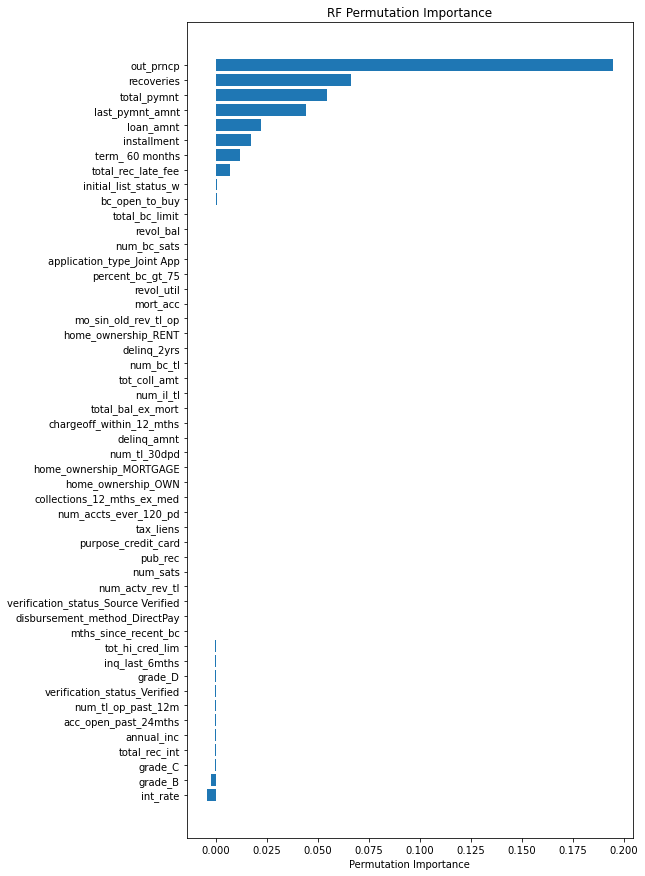

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('RF Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_300_GPU_precision_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Recall

### 100 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_recall_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf100gpu_trainvaltest_recall', 
                'save_code': 'False', 'notes': 'us_rf100gpu_trainvaltest_recall'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_100_GPU_recall.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = recall_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial recall:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_100_GPU_recall.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_recall.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)
wandb.finish()

- Trial time: 16.253273334819824
- Trial recall: 0.9011760186255385
######################################################
- Trial time: 52.76769037102349
- Trial recall: 0.9019774731661759
######################################################
- Trial time: 37.367596274008974
- Trial recall: 0.9063291726140996
######################################################
- Trial time: 28.0644954580348
- Trial recall: 0.9047726286715394
######################################################
- Trial time: 23.759777724044397
- Trial recall: 0.8930753665329805
######################################################
- Trial time: 16.900140109006315
- Trial recall: 0.8864815814486456
######################################################
- Trial time: 65.96078735683113
- Trial recall: 0.901702594129511
######################################################
- Trial time: 63.401370814070106
- Trial recall: 0.8986987954999321
######################################################
- Trial time: 26.9240

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'recall'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('recall', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_100_GPU_recall.csv', index=False)
print(trials_df) 

    iteration    recall             datetime_start          datetime_complete  \
91         91  0.907829 2022-09-22 05:16:46.035848 2022-09-22 05:17:59.172008   
75         75  0.907737 2022-09-22 04:58:18.837422 2022-09-22 04:59:32.254702   
44         44  0.907720 2022-09-22 04:23:24.255877 2022-09-22 04:24:27.560461   
74         74  0.907339 2022-09-22 04:57:05.501841 2022-09-22 04:58:18.837228   
80         80  0.907303 2022-09-22 05:04:29.415147 2022-09-22 05:05:43.909261   
..        ...       ...                        ...                        ...   
8           8  0.897477 2022-09-22 03:53:59.961952 2022-09-22 03:54:27.246681   
57         57  0.895741 2022-09-22 04:37:59.314584 2022-09-22 04:38:53.578205   
50         50  0.893821 2022-09-22 04:30:07.912111 2022-09-22 04:31:05.559466   
4           4  0.893075 2022-09-22 03:51:08.248904 2022-09-22 03:51:32.433165   
5           5  0.886482 2022-09-22 03:51:32.433444 2022-09-22 03:51:49.766928   

                 duration  

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_100_GPU_recall.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_100_GPU_recall.html')
fig.show()

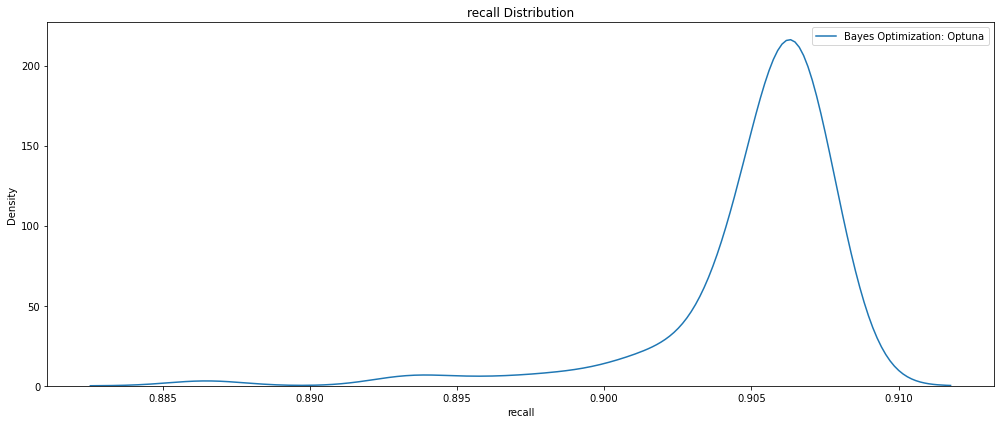

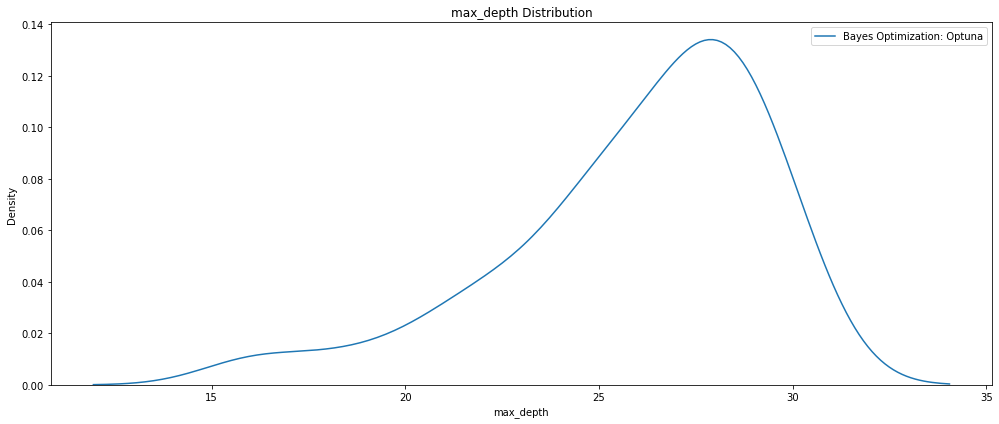

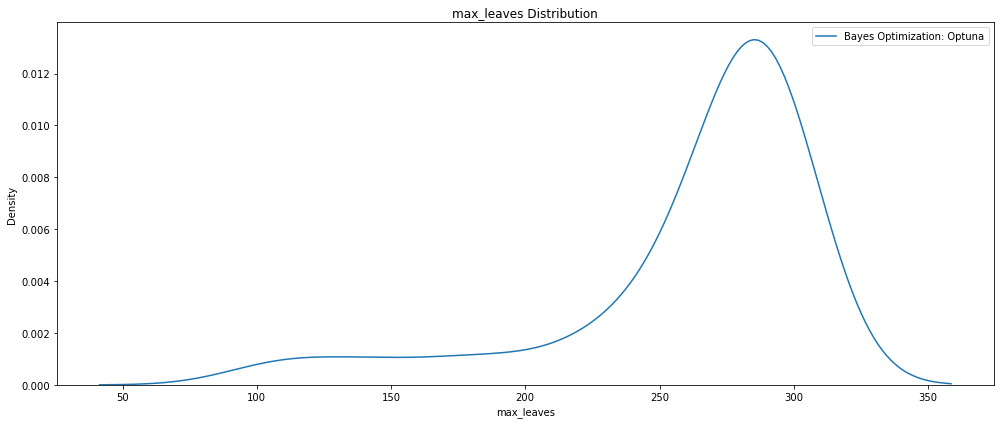

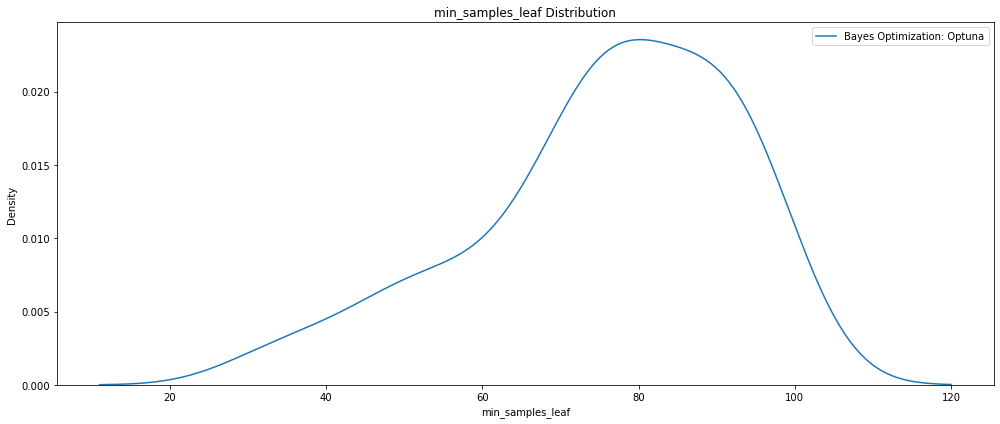

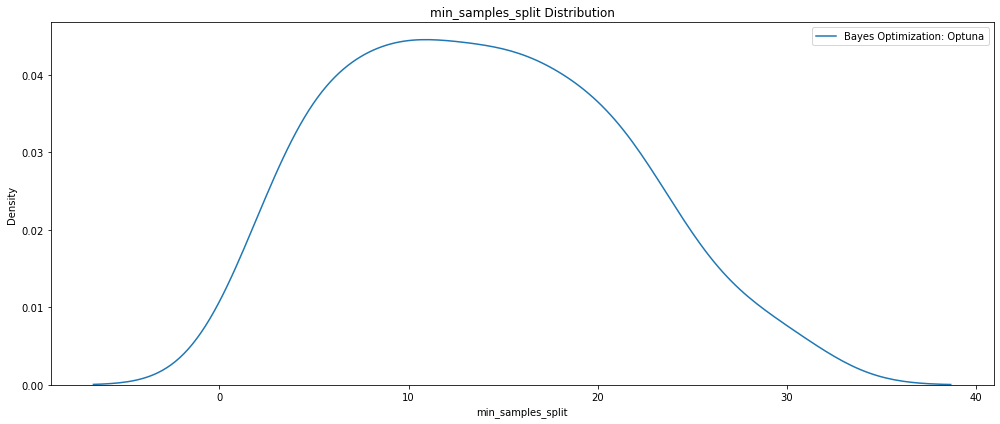

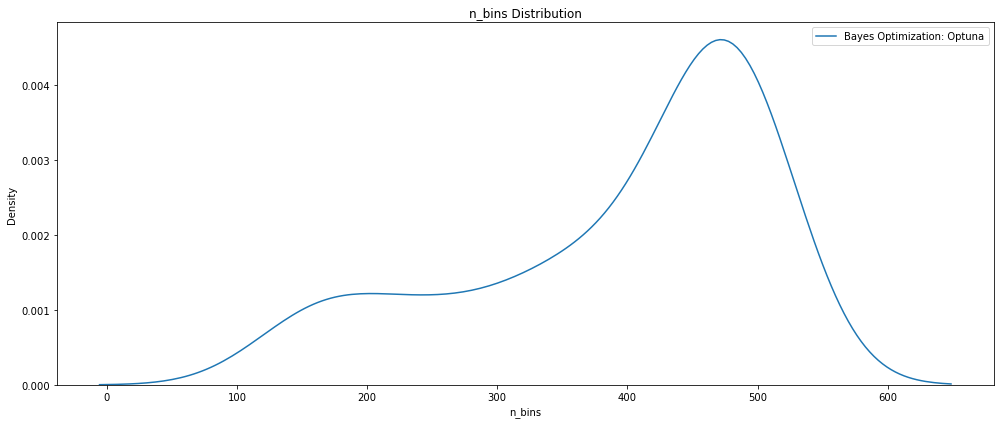

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

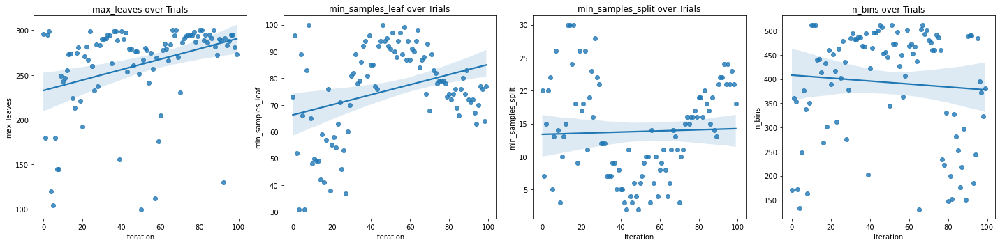

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_100_GPU_recall.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_100_GPU_recall.html')
fig.show()

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL
study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_recall.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_US_100_GPU_recall.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 100
Best trial: {'n_estimators': 477, 'max_depth': 28, 'max_leaves': 289, 'min_samples_leaf': 71, 'min_samples_split': 22, 'n_bins': 490}
Highest ROCweighted score 0.9078294160310779
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 477,
 'max_depth': 28,
 'max_leaves': 289,
 'min_samples_leaf': 71,
 'min_samples_split': 22,
 'n_bins': 490,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_100trials_GPU_recall.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_US_100trials_GPU_recall.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO US 100 trials GPU Recall')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO US 100 trials GPU Recall


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97    377848
           1       0.78      0.91      0.84     54625

    accuracy                           0.96    432473
   macro avg       0.88      0.93      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[363505  14343]
 [  5062  49563]]


Accuracy score : 0.955
Precision score : 0.776
Recall score : 0.907
F1 score : 0.836


In [ ]:
# Evaluate on the testing data 
print('The best model from US 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 100 GPU trials optimization scores 0.93469 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    91
recall                                 0.907829
datetime_start       2022-09-22 05:16:46.035848
datetime_complete    2022-09-22 05:17:59.172008
duration                 0 days 00:01:13.136160
max_depth                                    28
max_leaves                                  289
min_samples_leaf                             71
min_samples_split                            22
n_bins                                      490
n_estimators                                477
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_recall_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_recall_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1846 ± 0.0009,out_prncp
0.0660 ± 0.0002,recoveries
0.0495 ± 0.0002,last_pymnt_amnt
0.0477 ± 0.0002,total_pymnt
0.0181 ± 0.0003,loan_amnt
0.0140 ± 0.0002,installment
0.0102 ± 0.0003,term_ 60 months
0.0069 ± 0.0003,total_rec_late_fee
0.0005 ± 0.0000,initial_list_status_w
0.0004 ± 0.0000,total_bc_limit


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_100_GPU_recall_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,0.184649,0.000467
1,recoveries,0.065984,0.000124
2,last_pymnt_amnt,0.049465,0.000087
3,total_pymnt,0.047730,0.000103
4,loan_amnt,0.018097,0.000138
5,installment,0.013981,0.000079
6,term_ 60 months,0.010228,0.000131
7,total_rec_late_fee,0.006862,0.000174
8,initial_list_status_w,0.000510,0.000016
9,total_bc_limit,0.000442,0.000024


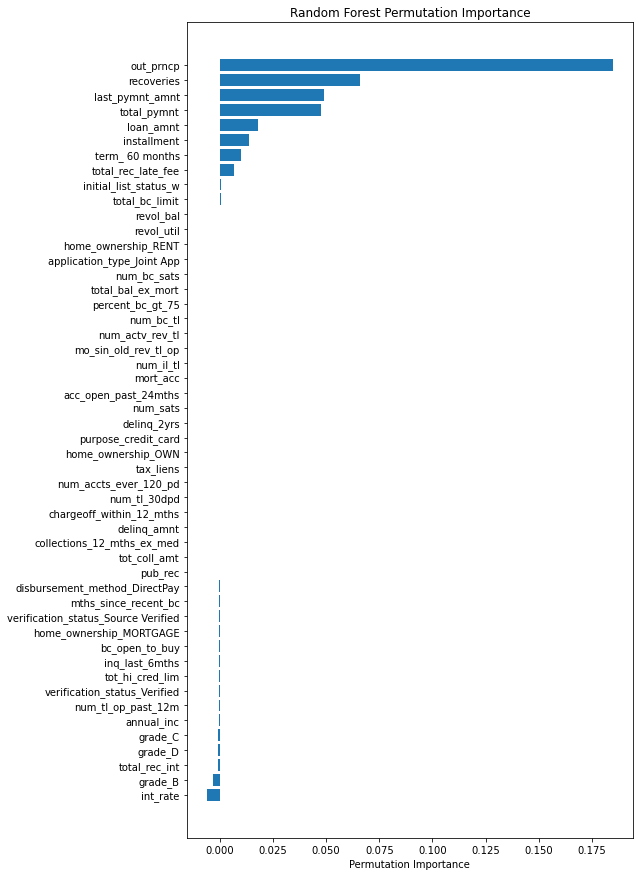

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_100_GPU_recall_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_recall_300_tpe'

In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf300gpu_trainvaltest_recall', 
                'save_code': 'False', 'notes': 'us_rf300gpu_trainvaltest_recall'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_300_GPU_recall.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 20, 50), 
        'max_leaves': trial.suggest_int('max_leaves', 275, 400), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 60, 150),
        'min_samples_split': trial.suggest_int('min_samples_split', 3, 40),
        'n_bins': trial.suggest_int('n_bins', 150, 600),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = recall_score(asnumpy(y_val), asnumpy(y_pred_val))
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial recall:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_recall.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_recall.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)
wandb.finish()

- Trial time: 86.46455241087824
- Trial recall: 0.9078813132651439
######################################################
- Trial time: 95.10748900007457
- Trial recall: 0.9094579733955165
######################################################
- Trial time: 99.47577355988324
- Trial recall: 0.9061291006412634
######################################################
- Trial time: 115.24534371402115
- Trial recall: 0.9087193279983041
######################################################
- Trial time: 123.43155092792585
- Trial recall: 0.9067352535905453
######################################################
- Trial time: 77.98777369596064
- Trial recall: 0.9064040224707192
######################################################
- Trial time: 110.50222486164421
- Trial recall: 0.9069240553288462
######################################################
- Trial time: 75.24227720079944
- Trial recall: 0.9070101754200011
######################################################
- Trial time: 81.8095

In [ ]:
study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_recall.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)

Number of finished trials: 161
Best trial: {'n_estimators': 519, 'max_depth': 31, 'max_leaves': 396, 'min_samples_leaf': 92, 'min_samples_split': 30, 'n_bins': 340}
Highest Recall Score 0.9102131803487201


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_recall.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_recall.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=139)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest Recall Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 78.49430882092565
- Trial recall: 0.909984956626043
######################################################
- Trial time: 75.2280356278643
- Trial recall: 0.9095442586665076
######################################################
- Trial time: 76.98603742616251
- Trial recall: 0.9092824907055806
######################################################
- Trial time: 74.9750499506481
- Trial recall: 0.9092029662617547
######################################################
- Trial time: 77.35508235590532
- Trial recall: 0.9099153727376953
######################################################
- Trial time: 76.39284558221698
- Trial recall: 0.9098027131089419
######################################################
- Trial time: 78.66398176876828
- Trial recall: 0.9090737390405376
######################################################
- Trial time: 76.61940594855696
- Trial recall: 0.9095508857034931
######################################################
- Trial time: 98.3008400220

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'recall'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('recall', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_300_GPU_recall.csv', index=False)
print(trials_df) 

     iteration    recall             datetime_start  \
58          58  0.910213 2022-09-28 21:14:20.889869   
206        206  0.910171 2022-09-29 02:05:58.738602   
121        121  0.910114 2022-09-28 22:56:28.542083   
119        119  0.910114 2022-09-28 22:53:27.033819   
151        151  0.910104 2022-09-28 23:42:12.243438   
..         ...       ...                        ...   
50          50  0.906397 2022-09-28 21:02:39.437517   
127        127  0.906225 2022-09-28 23:05:39.652370   
2            2  0.906129 2022-09-28 19:45:39.918893   
35          35  0.906053 2022-09-28 20:38:38.157050   
160        160       NaN 2022-09-28 23:56:01.956926   

             datetime_complete               duration  max_depth  max_leaves  \
58  2022-09-28 21:16:00.706081 0 days 00:01:39.816212       31.0       396.0   
206 2022-09-29 02:07:13.304294 0 days 00:01:14.565692       29.0       384.0   
121 2022-09-28 22:58:02.188529 0 days 00:01:33.646446       27.0       393.0   
119 2022-09-28 22:5

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_300_GPU_recall.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_300_GPU_recall.html')
fig.show()

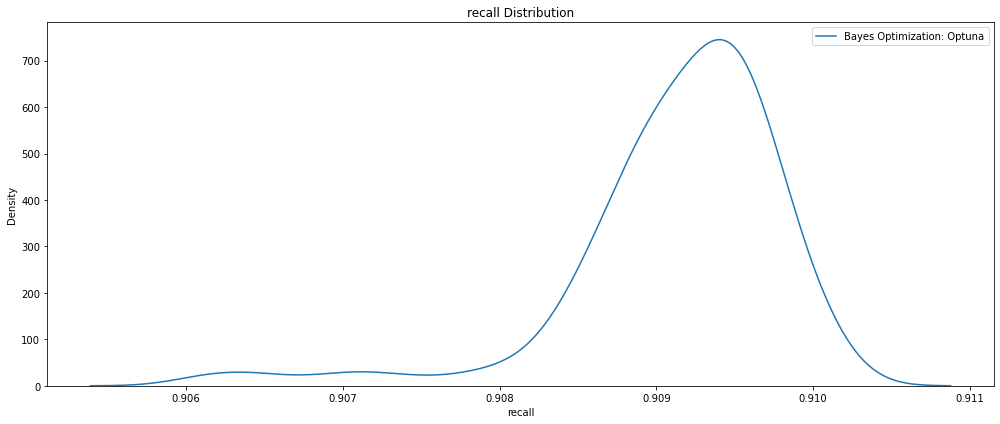

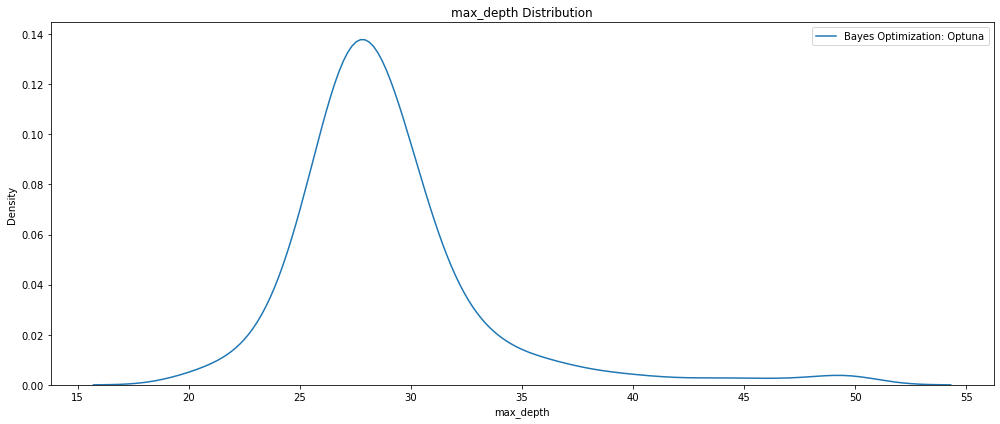

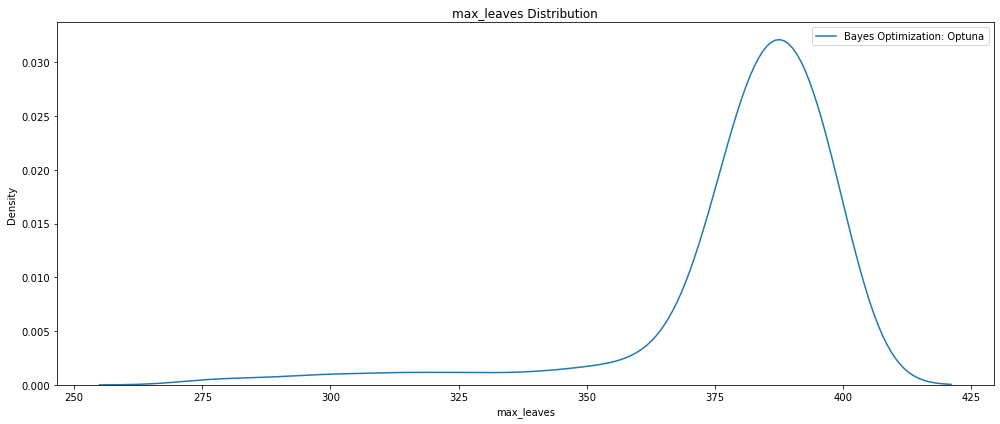

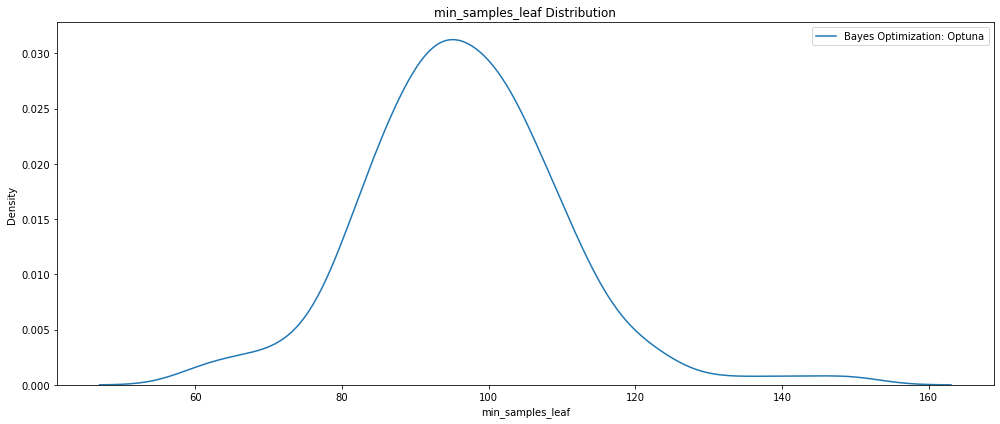

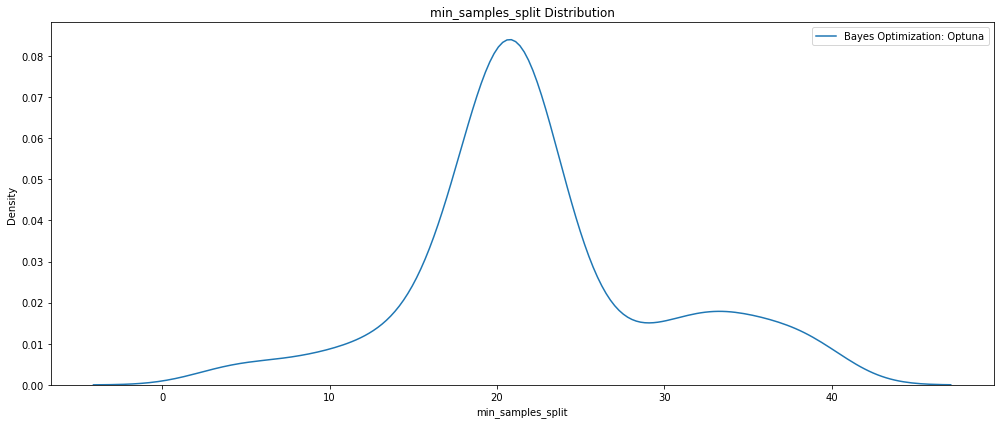

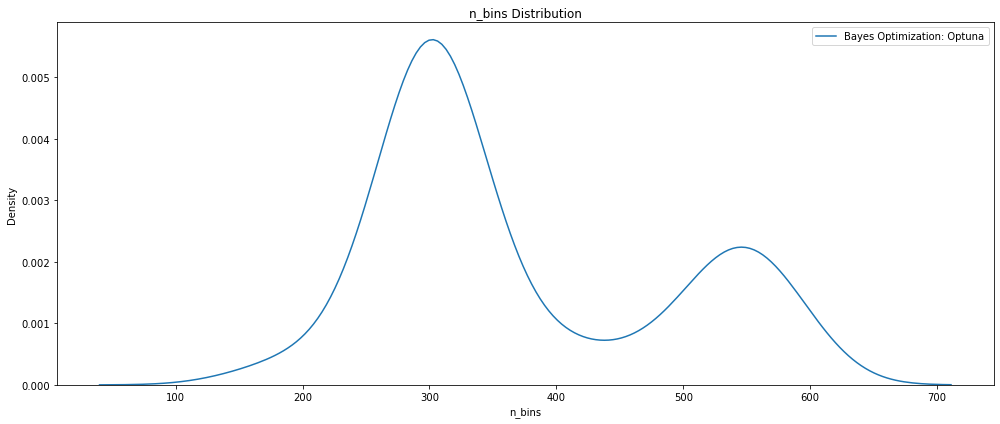

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

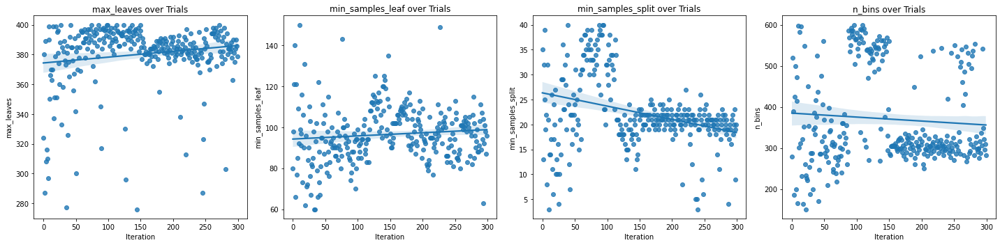

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_300_GPU_recall.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_300_GPU_recall.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 519,
 'max_depth': 31,
 'max_leaves': 396,
 'min_samples_leaf': 92,
 'min_samples_split': 30,
 'n_bins': 340,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_300trials_GPU_recall.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_US_300trials_GPU_recall.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO US 300 trials GPU Recall')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO US 300 trials GPU Recall


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.97      0.98    377848
           1       0.80      0.91      0.85     54625

    accuracy                           0.96    432473
   macro avg       0.89      0.94      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[365171  12677]
 [  4911  49714]]


Accuracy score : 0.959
Precision score : 0.797
Recall score : 0.910
F1 score : 0.850


In [ ]:
# Evaluate on the testing data 
print('The best model from US 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 300 GPU trials optimization scores 0.93827 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    58
recall                                 0.910213
datetime_start       2022-09-28 21:14:20.889869
datetime_complete    2022-09-28 21:16:00.706081
duration                 0 days 00:01:39.816212
max_depth                                  31.0
max_leaves                                396.0
min_samples_leaf                           92.0
min_samples_split                          30.0
n_bins                                    340.0
n_estimators                              519.0
state                                  COMPLETE
Name: 58, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_recall_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_recall_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1940 ± 0.0010,out_prncp
0.0661 ± 0.0002,recoveries
0.0536 ± 0.0002,total_pymnt
0.0442 ± 0.0002,last_pymnt_amnt
0.0203 ± 0.0002,loan_amnt
0.0161 ± 0.0002,installment
0.0103 ± 0.0002,term_ 60 months
0.0068 ± 0.0004,total_rec_late_fee
0.0005 ± 0.0001,initial_list_status_w
0.0003 ± 0.0000,bc_open_to_buy


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_300_GPU_recall_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,1.940450e-01,0.000511
1,recoveries,6.606934e-02,0.000104
2,total_pymnt,5.362924e-02,0.000106
3,last_pymnt_amnt,4.417201e-02,0.000081
4,loan_amnt,2.033792e-02,0.000118
5,installment,1.609674e-02,0.000108
6,term_ 60 months,1.026884e-02,0.000120
7,total_rec_late_fee,6.769001e-03,0.000183
8,initial_list_status_w,4.911184e-04,0.000041
9,bc_open_to_buy,3.473043e-04,0.000024


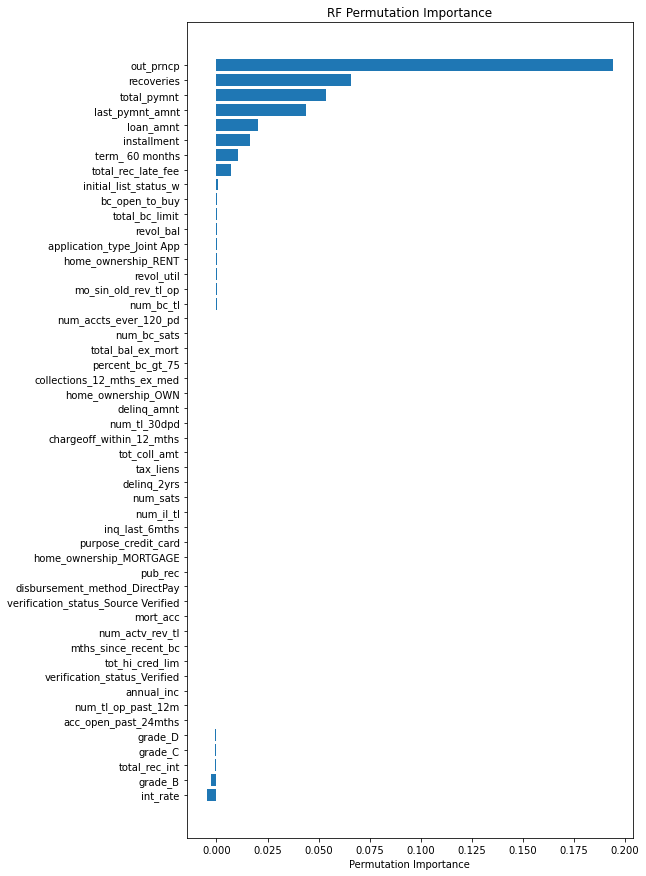

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('RF Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_300_GPU_recall_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

## Weighted ROC

### 100 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_wROC_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf00gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'us_rf100gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 16, 30), 
        'max_leaves': trial.suggest_int('max_leaves', 100, 300), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 30, 100),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 30),
        'n_bins': trial.suggest_int('n_bins', 128, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = roc_auc_score(y_val.to_numpy(), y_pred_val.to_numpy(), 
                          average='weighted')
     
    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)
wandb.finish()

- Trial time: 70.75160919502378
- Trial weighted ROC: 0.9320555802757059
######################################################
- Trial time: 41.7098145338241
- Trial weighted ROC: 0.9292879993809606
######################################################
- Trial time: 37.14995856001042
- Trial weighted ROC: 0.9331669496662283
######################################################
- Trial time: 64.51428782194853
- Trial weighted ROC: 0.9325732008770606
######################################################
- Trial time: 71.99239781079814
- Trial weighted ROC: 0.934401778080966
######################################################
- Trial time: 45.10074548679404
- Trial weighted ROC: 0.9335897755540451
######################################################
- Trial time: 32.36306320410222
- Trial weighted ROC: 0.9327660442016933
######################################################
- Trial time: 56.43023493513465
- Trial weighted ROC: 0.9322935582080806
#################################

In [ ]:
study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)

Number of finished trials: 66
Best trial: {'n_estimators': 379, 'max_depth': 19, 'max_leaves': 298, 'min_samples_leaf': 78, 'min_samples_split': 25, 'n_bins': 357}
Highest ROCweighted score 0.9359039340227993


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=35)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)
wandb.finish()

- Trial time: 51.69181027007289
- Trial weighted ROC: 0.9342855401444486
######################################################
- Trial time: 64.52901424001902
- Trial weighted ROC: 0.9352080295551439
######################################################
- Trial time: 60.110517425928265
- Trial weighted ROC: 0.9339218288975782
######################################################
- Trial time: 66.73484188015573
- Trial weighted ROC: 0.934982345525254
######################################################
- Trial time: 56.7665841858834
- Trial weighted ROC: 0.9345802431615142
######################################################
- Trial time: 64.20363920391537
- Trial weighted ROC: 0.9347111100592734
######################################################
- Trial time: 53.66468536504544
- Trial weighted ROC: 0.9344476719678192
######################################################
- Trial time: 67.12684445781633
- Trial weighted ROC: 0.9292282698098482
################################

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'roc_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.csv', index=False)
print(trials_df) 

    iteration  roc_weighted             datetime_start  \
84         84      0.936063 2022-09-23 14:58:25.151550   
46         46      0.935904 2022-09-22 06:10:53.425296   
13         13      0.935736 2022-09-22 05:39:22.018341   
23         23      0.935605 2022-09-22 05:48:26.231613   
45         45      0.935553 2022-09-22 06:09:56.633727   
..        ...           ...                        ...   
54         54      0.923284 2022-09-22 06:18:23.755040   
8           8      0.922823 2022-09-22 05:34:42.564901   
61         61           NaN 2022-09-22 06:24:59.456037   
62         62           NaN 2022-09-23 14:29:21.550857   
65         65           NaN 2022-09-23 14:37:00.886177   

            datetime_complete               duration  max_depth  max_leaves  \
84 2022-09-23 14:59:41.004119 0 days 00:01:15.852569       20.0       299.0   
46 2022-09-22 06:11:51.070524 0 days 00:00:57.645228       19.0       298.0   
13 2022-09-22 05:40:36.234534 0 days 00:01:14.216193       26.0   

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

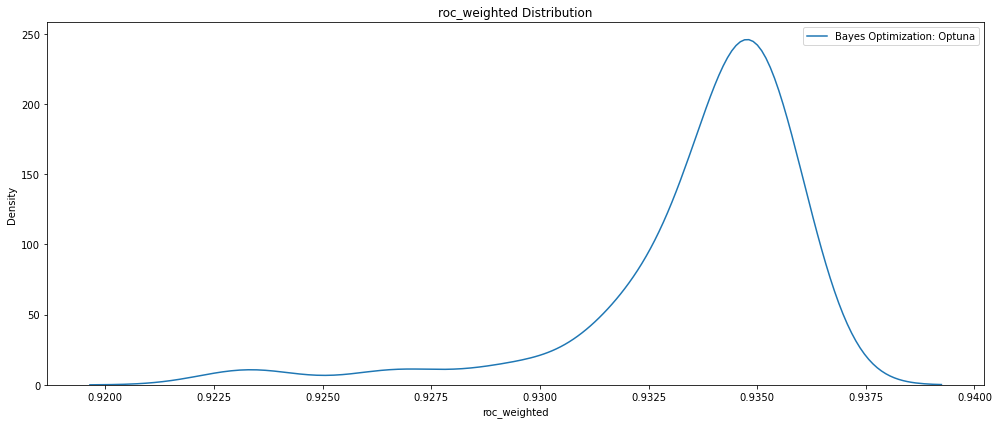

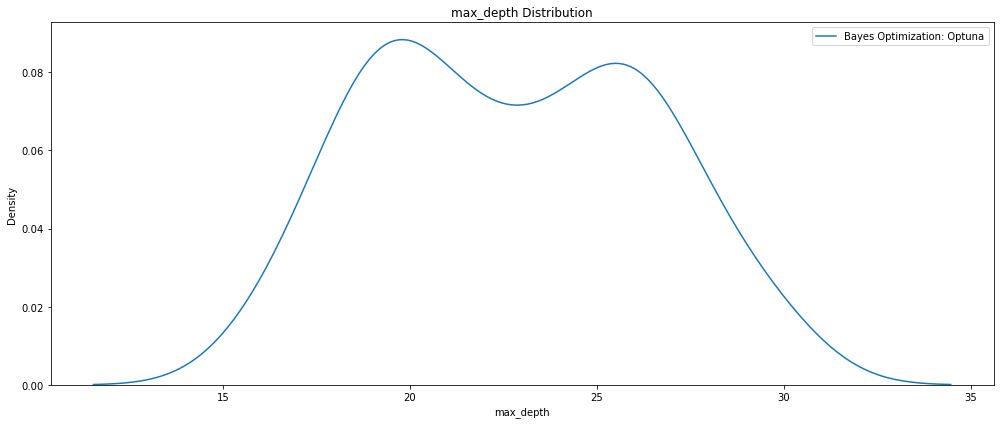

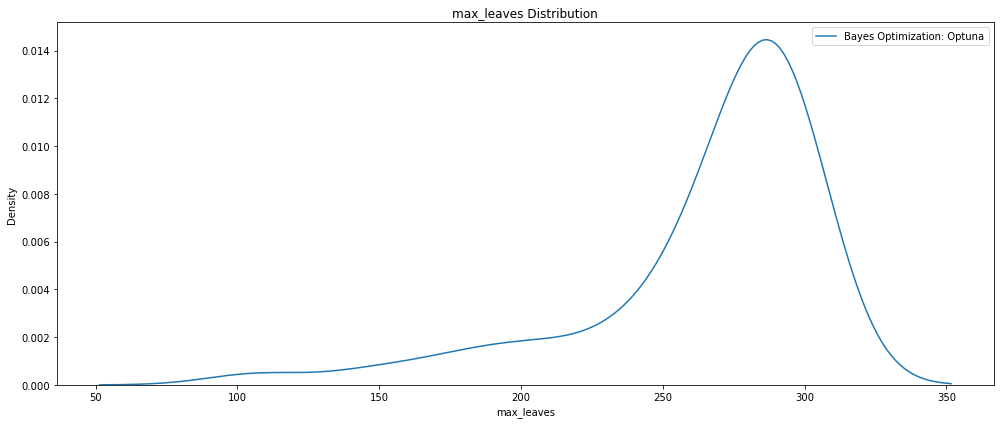

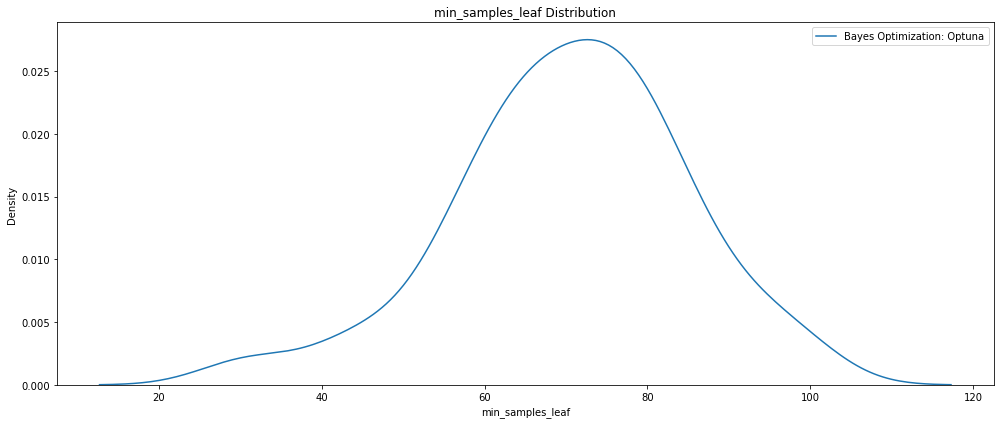

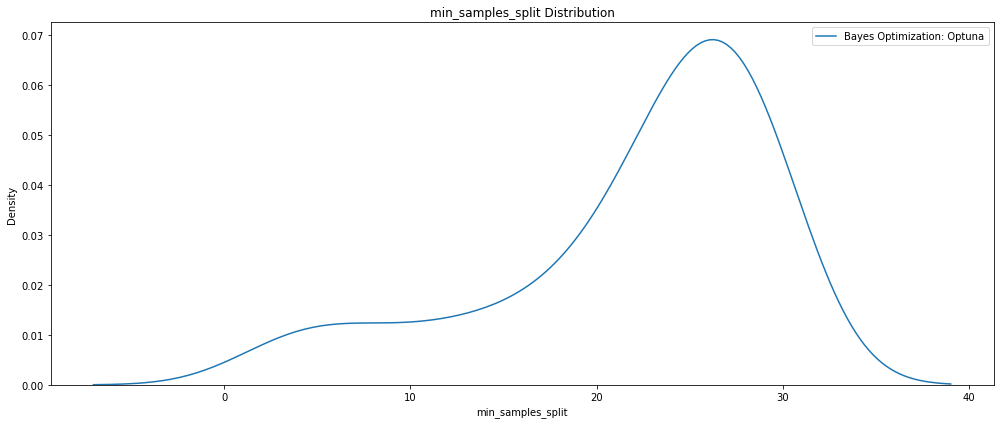

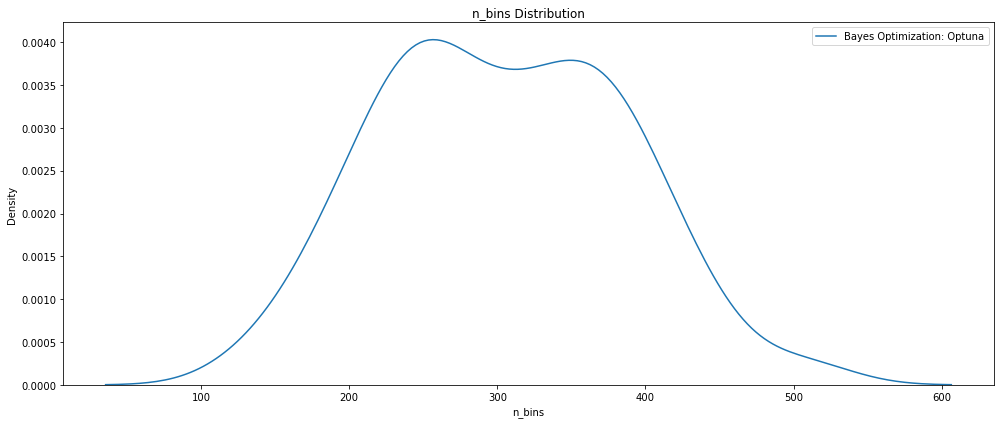

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

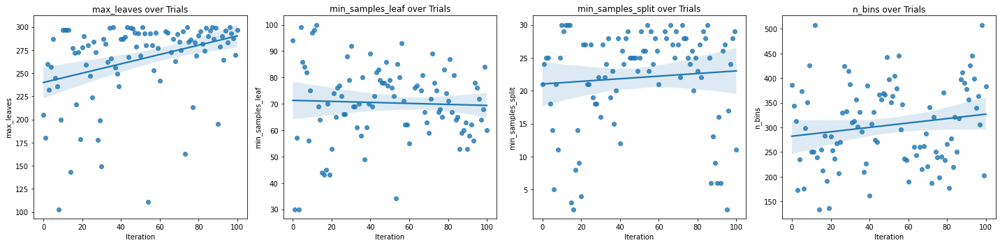

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL
study = joblib.load('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_US_100_GPU_ROCweighted.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 101
Best trial: {'n_estimators': 485, 'max_depth': 20, 'max_leaves': 299, 'min_samples_leaf': 64, 'min_samples_split': 28, 'n_bins': 321}
Highest ROCweighted score 0.9360631572870628
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 485,
 'max_depth': 20,
 'max_leaves': 299,
 'min_samples_leaf': 64,
 'min_samples_split': 28,
 'n_bins': 321,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_trials100_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_USUS_trials100_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO US 100 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO US 100 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97    377848
           1       0.78      0.91      0.84     54625

    accuracy                           0.96    432473
   macro avg       0.88      0.93      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[363616  14232]
 [  5115  49510]]


Accuracy score : 0.955
Precision score : 0.777
Recall score : 0.906
F1 score : 0.837


In [ ]:
# Evaluate on the testing data 
print('The best model from US 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 100 GPU trials optimization scores 0.93435 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    84
roc_weighted                           0.936063
datetime_start       2022-09-23 14:58:25.151550
datetime_complete    2022-09-23 14:59:41.004119
duration                 0 days 00:01:15.852569
max_depth                                  20.0
max_leaves                                299.0
min_samples_leaf                           64.0
min_samples_split                          28.0
n_bins                                    321.0
n_estimators                              485.0
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_100_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1846 ± 0.0009,out_prncp
0.0664 ± 0.0002,recoveries
0.0493 ± 0.0001,last_pymnt_amnt
0.0479 ± 0.0002,total_pymnt
0.0179 ± 0.0003,loan_amnt
0.0140 ± 0.0002,installment
0.0094 ± 0.0003,term_ 60 months
0.0067 ± 0.0003,total_rec_late_fee
0.0006 ± 0.0000,initial_list_status_w
0.0002 ± 0.0000,total_bc_limit


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_100_GPU_ROCweighted_WeightsExplain.csv', 
           index=False)
exp

,feature,weight,std
0,out_prncp,0.184553,0.000471
1,recoveries,0.066374,0.000079
2,last_pymnt_amnt,0.049282,0.000045
3,total_pymnt,0.047865,0.000107
4,loan_amnt,0.017934,0.000140
5,installment,0.013975,0.000108
6,term_ 60 months,0.009443,0.000127
7,total_rec_late_fee,0.006685,0.000171
8,initial_list_status_w,0.000576,0.000024
9,total_bc_limit,0.000223,0.000019


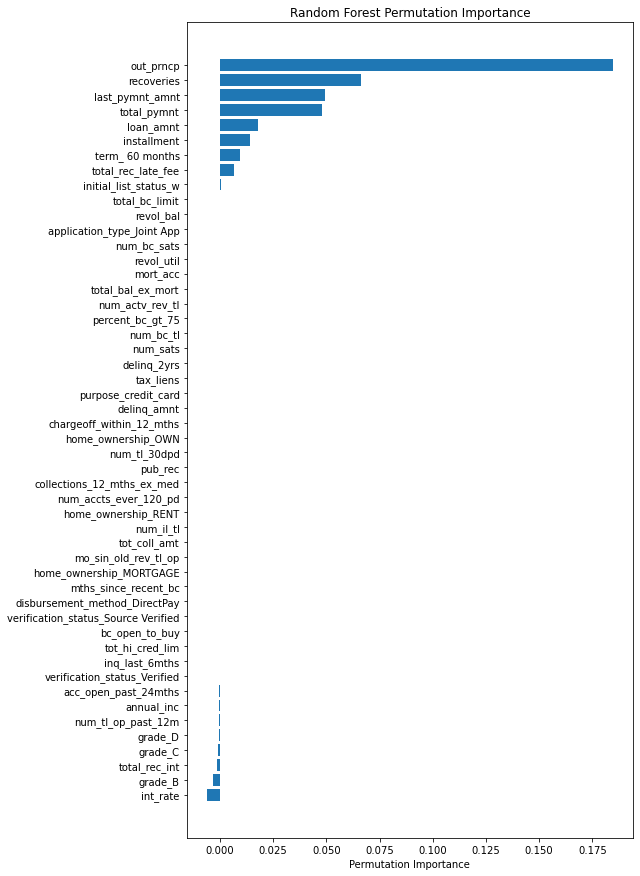

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_100_GPU_ROCweighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');

### 300 Trials

In [ ]:
# Define a name for the trials
study_name = 'dask_optuna_US_rfRapids_wROC_300_tpe'

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_rf300gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'us_rf300gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
    """
    Objective function to tune a `RandomForestClassifier` model.
    """
    joblib.dump(study, 'rfRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_rf_optuna = { 
        'n_estimators': trial.suggest_int('n_estimators', 300, 700),
        'max_depth': trial.suggest_int('max_depth', 16, 40), 
        'max_leaves': trial.suggest_int('max_leaves', 280, 400), 
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 50, 120),
        'min_samples_split': trial.suggest_int('min_samples_split', 6, 40),
        'n_bins': trial.suggest_int('n_bins', 200, 512),
    }

    # Define model type
    model = RandomForestClassifier(random_state=seed_value, 
                                   n_streams=1, 
                                   **params_rf_optuna)
    
    # Start timer for each trial
    start = timer()

    model.fit(X_train, y_train)    
    
    # Predictions
    y_pred_val = model.predict(X_val)
    score = roc_auc_score(y_val.to_numpy(), y_pred_val.to_numpy(), 
                          average='weighted')
     
    run_time = timer() - start

    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 103.66326775215566
- Trial weighted ROC: 0.9364741998543277
######################################################
- Trial time: 91.3560555758886
- Trial weighted ROC: 0.9372742125314543
######################################################
- Trial time: 63.52145140292123
- Trial weighted ROC: 0.9365568150679059
######################################################
- Trial time: 59.52931937389076
- Trial weighted ROC: 0.9370026432254237
######################################################
- Trial time: 105.3681391668506
- Trial weighted ROC: 0.9385098969806548
######################################################
- Trial time: 49.99320978205651
- Trial weighted ROC: 0.9379219925514978
######################################################
- Trial time: 95.12312380736694
- Trial weighted ROC: 0.9352928624099082
######################################################
- Trial time: 46.35551464278251
- Trial weighted ROC: 0.9360681452622507
###############################

In [ ]:
study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)

Number of finished trials: 296
Best trial: {'n_estimators': 427, 'max_depth': 22, 'max_leaves': 399, 'min_samples_leaf': 102, 'min_samples_split': 16, 'n_bins': 203}
Highest ROCweighted score 0.9397582035304102


In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl'): 
        study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=4)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 73.7661707859952
- Trial weighted ROC: 0.9388198976436531
######################################################
- Trial time: 70.21340248617344
- Trial weighted ROC: 0.9384496127552396
######################################################
- Trial time: 72.50511522917077
- Trial weighted ROC: 0.9389324043503995
######################################################
- Trial time: 71.31242776894942
- Trial weighted ROC: 0.9387468136887684
######################################################
..dask_optuna             :  295.0376
Time to run HPO: 295.03797721862793


Number of finished trials: 300
Best trial: {'n_estimators': 427, 'max_depth': 22, 'max_leaves': 399, 'min_samples_leaf': 102, 'min_samples_split': 16, 'n_bins': 203}
Highest ROCweighted score 0.9397582035304102


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number':'iteration'}, inplace=True)
trials_df.rename(columns={'value':'roc_weighted'},inplace=True)
trials_df.rename(columns={'params_max_depth':'max_depth'}, inplace=True)
trials_df.rename(columns={'params_max_leaves':'max_leaves'}, inplace=True)
trials_df.rename(columns={'params_min_samples_leaf':'min_samples_leaf'}, 
                 inplace=True)
trials_df.rename(columns={'params_min_samples_split':'min_samples_split'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_bins':'n_bins'}, inplace=True)
trials_df.rename(columns={'params_n_estimators':'n_estimators'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.csv', index=False)
print(trials_df) 

     iteration  roc_weighted             datetime_start  \
56          56      0.939758 2022-09-30 22:08:31.572231   
85          85      0.939526 2022-09-30 22:42:57.368440   
132        132      0.939378 2022-09-30 23:38:59.329241   
116        116      0.939374 2022-09-30 23:20:56.141477   
156        156      0.939365 2022-10-01 00:06:53.616452   
..         ...           ...                        ...   
70          70      0.935648 2022-09-30 22:25:12.614799   
120        120      0.935646 2022-09-30 23:25:29.510911   
6            6      0.935293 2022-09-30 21:07:47.743828   
30          30      0.935278 2022-09-30 21:37:40.832542   
295        295           NaN 2022-10-01 02:43:05.023870   

             datetime_complete               duration  max_depth  max_leaves  \
56  2022-09-30 22:09:37.009557 0 days 00:01:05.437326       22.0       399.0   
85  2022-09-30 22:44:01.581829 0 days 00:01:04.213389       23.0       390.0   
132 2022-09-30 23:40:09.192572 0 days 00:01:09.8633

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_rfRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_rfRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_rfRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['max_leaves', 
                                                       'min_samples_leaf',
                                                       'max_depth', 
                                                       'min_samples_split'])
py.plot(fig, filename='contour_rfRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

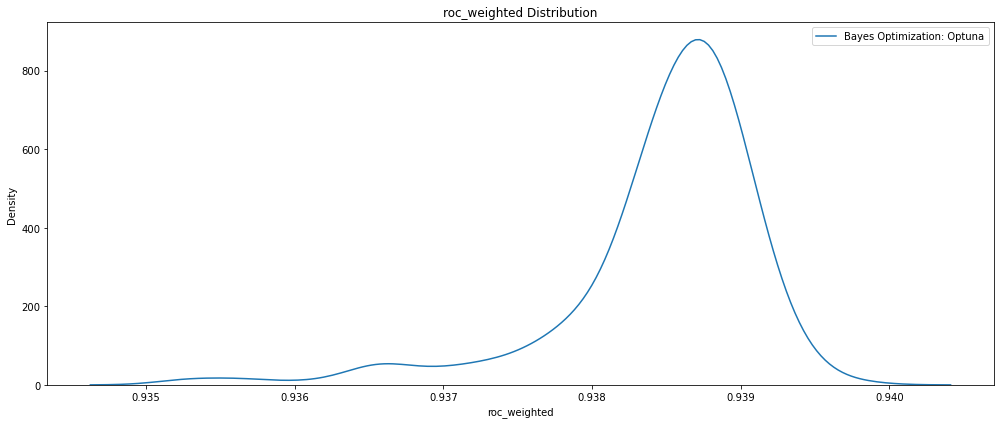

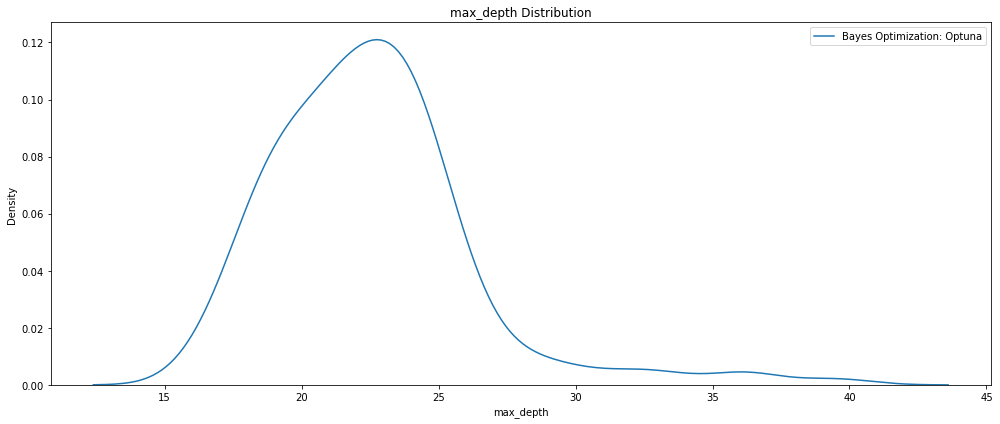

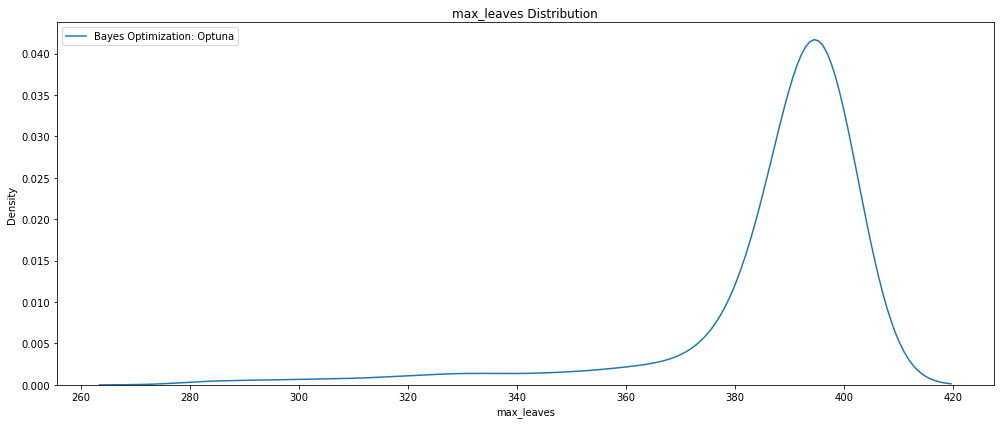

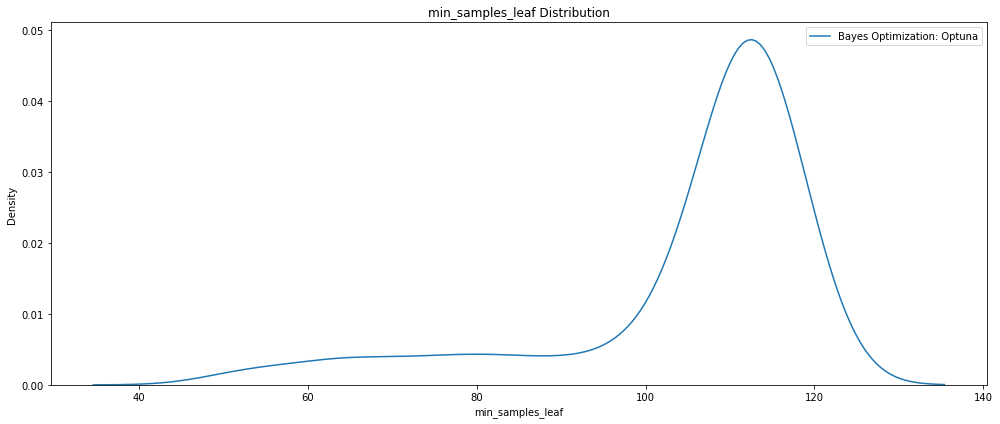

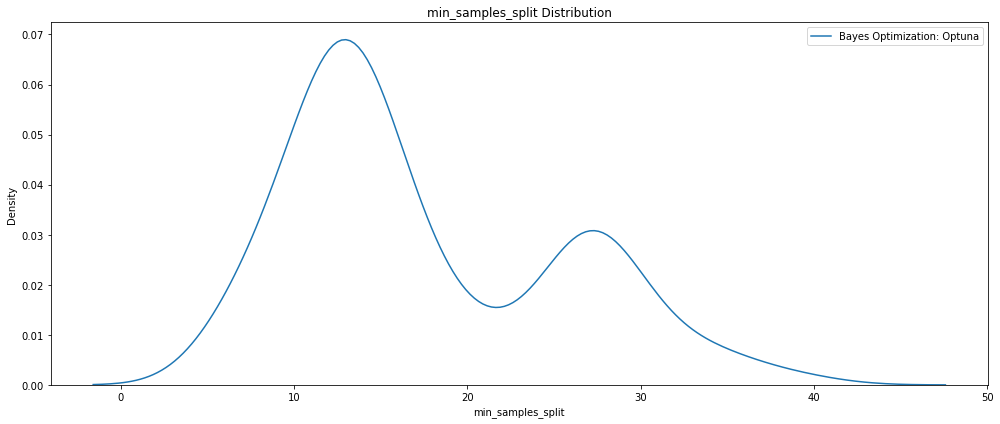

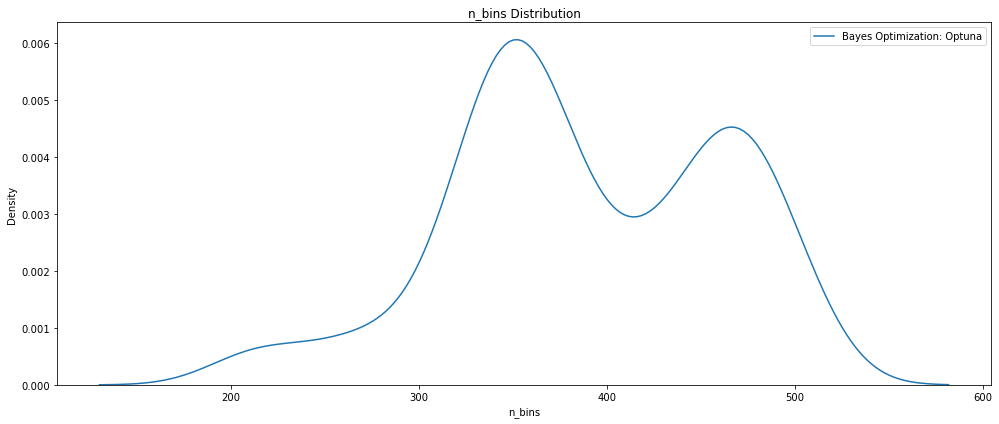

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the random search distribution and the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc = 0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

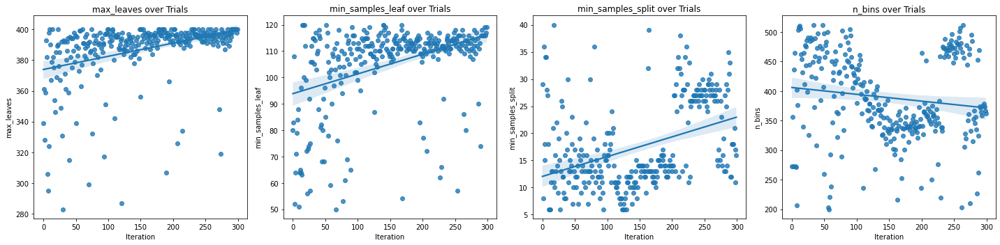

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['max_leaves', 'min_samples_leaf', 'min_samples_split',
                         'n_bins']): 
                         # Scatterplot
                         sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
                         axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
                                    title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_rfRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_rfRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL

study = joblib.load('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest ROCweighted score', study.best_value)

# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/trialOptions

trials_df = pd.read_csv('rfRAPIDS_Optuna_US_300_GPU_ROCweighted.csv')

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL
Number of finished trials: 300
Best trial: {'n_estimators': 427, 'max_depth': 22, 'max_leaves': 399, 'min_samples_leaf': 102, 'min_samples_split': 16, 'n_bins': 203}
Highest ROCweighted score 0.9397582035304102
/notebooks/LoanStatus/Python/ML/RF/Optuna/trialOptions


In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params

{'n_estimators': 427,
 'max_depth': 22,
 'max_leaves': 399,
 'min_samples_leaf': 102,
 'min_samples_split': 16,
 'n_bins': 203,
 'random_state': 42}

In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_PKL/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = RandomForestClassifier(n_streams=1, 
                                    **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'rfRAPIDS_Optuna_US_trials300_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('rfRAPIDS_Optuna_USUS_trials300_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for Random Forest RAPIDS HPO US 300 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)

print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f'%accuracy_score(asnumpy(y_test), 
                                             asnumpy(y_test_pred)))
print('Precision score : %.3f'%precision_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Recall score : %.3f'%recall_score(asnumpy(y_test), 
                                         asnumpy(y_test_pred)))
print('F1 score : %.3f'%f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for Random Forest RAPIDS HPO US 300 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.97      0.98    377848
           1       0.80      0.91      0.85     54625

    accuracy                           0.96    432473
   macro avg       0.89      0.94      0.91    432473
weighted avg       0.96      0.96      0.96    432473



Confusion matrix:
[[365293  12555]
 [  4942  49683]]


Accuracy score : 0.960
Precision score : 0.798
Recall score : 0.910
F1 score : 0.850


In [ ]:
# Evaluate on the testing data 
print('The best model from US 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                       asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from US 300 GPU trials optimization scores 0.93815 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    56
roc_weighted                           0.939758
datetime_start       2022-09-30 22:08:31.572231
datetime_complete    2022-09-30 22:09:37.009557
duration                 0 days 00:01:05.437326
max_depth                                  22.0
max_leaves                                399.0
min_samples_leaf                          102.0
min_samples_split                          16.0
n_bins                                    203.0
n_estimators                              427.0
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
# Write results to ML Results
%cd /notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/

/notebooks/LoanStatus/Python/ML/RF/Optuna/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(X_test.to_numpy(), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/RF/Optuna/Model_Explanations/rfRAPIDS_Optuna_US_300_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.1932 ± 0.0009,out_prncp
0.0669 ± 0.0002,recoveries
0.0533 ± 0.0002,total_pymnt
0.0451 ± 0.0001,last_pymnt_amnt
0.0214 ± 0.0002,loan_amnt
0.0164 ± 0.0003,installment
0.0110 ± 0.0002,term_ 60 months
0.0066 ± 0.0003,total_rec_late_fee
0.0005 ± 0.0001,initial_list_status_w
0.0003 ± 0.0001,total_bc_limit


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_train.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('rfRAPIDS_Optuna_US_300_GPU_ROCweighted_WeightsExplain.csv', 
           index=False)
exp

,feature,weight,std
0,out_prncp,0.193156,0.000451
1,recoveries,0.066859,0.000079
2,total_pymnt,0.053282,0.000084
3,last_pymnt_amnt,0.045100,0.000066
4,loan_amnt,0.021411,0.000100
5,installment,0.016386,0.000125
6,term_ 60 months,0.010968,0.000125
7,total_rec_late_fee,0.006649,0.000171
8,initial_list_status_w,0.000483,0.000030
9,total_bc_limit,0.000315,0.000033


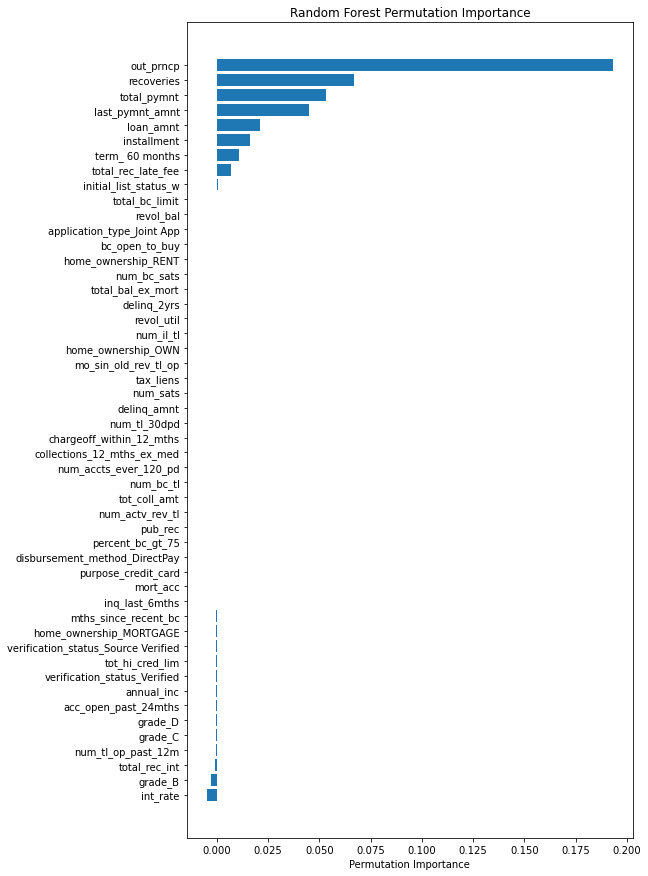

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()

plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Random Forest Permutation Importance')
fig.savefig('rfRAPIDS_Optuna_US_300_GPU_ROCweighted_permImportance.png', 
            dpi=my_dpi, bbox_inches='tight');